# Information Demand and market volatility

In [1]:
from pytrends.request import TrendReq
import pandas_datareader as pdr
import pandas as pd
import pandas_datareader.data as web
import pandas as pd
import numpy as np

from datetime import date
import datetime
import time

import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import statsmodels.tsa.stattools as ts
import statsmodels.tsa.arima_model as am
from statsmodels.tsa.api import VAR, DynamicVAR, VARMAX
from statsmodels.stats.diagnostic import *
from statsmodels.stats.stattools import *
import scipy.stats as scs
import scipy
import arch

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

path = r'\data\\'

C:\Anaconda3\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


# Subjects of study

In this work we will use the 30 stocks that conform the Dow Jones index. These are the following:

In [2]:
series = {'MMM':'3M',
'AXP':'American Express',
'AAPL':'Apple',
'BA':'Boeing',
'CAT':'Caterpillar',
'CVX':'Chevron',
'CSCO':'Cisco',
'KO':'Coca-Cola',
'DIS':'Disney',
'XOM':'Exxon Mobil',
'GE':'General Electric',
'GS':'Goldman Sachs',
'HD':'Home Depot',
'IBM':'IBM',
'INTC':'Intel',
'JNJ':'Johnson & Johnson',
'JPM':'JPMorgan Chase',
'MCD':'McDonald\'s',
'MRK':'Merck',
'MSFT':'Microsoft',
'NKE':'Nike',
'PFE':'Pfizer',
'PG':'Procter & Gamble',
'TRV':'Travelers Companies Inc',
'UTX':'United Technologies',
'UNH':'UnitedHealth',
'VZ':'Verizon',
'V':'Visa',
'WMT':'Wal-Mart',
'^DJI':'Dow Jones',
'SPY':'s&p500'}

Plotting function

In [3]:
def tsplot(y, lags=None, figsize=(10, 8), style='bmh', title = 'Time Series', time_id = 'date' ):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        pp_ax = plt.subplot2grid(layout, (2, 1))
        
        ts_ax.plot(time_id, y)
        ts_ax.set_title(title+' Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.5)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)
        sm.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')        
        scs.probplot(y, sparams=(y.mean(), y.std()), plot=pp_ax)

        plt.tight_layout()
    return

# Information demand

The information demand will be retreived as the SVI index taken from Google Trends. For that, we call the pytrends API

https://github.com/GeneralMills/pytrends#common-api-parameters

The data obtained has a monthly frequency. We keep the S&P500 index as the market meassure for information demand. 

In [4]:
def get_SVI(term):
    ''' Get SVI for a given term on Google Trends '''
    count = 0.5
    
    while True:
        print(term)
        time.sleep(count)
        term = term.lower()
        pytrends = TrendReq(hl='en')

        pytrends.build_payload([term], # Terminos de busqueda
                                       cat=0, # category to narrow result
                                       timeframe='all'
                                      )
        # Get time series for term
        df = pytrends.interest_over_time()

        # Filter finished days
        df['isPartial'] = df['isPartial'].map(lambda x: x == 'False')
        df = df[df['isPartial']]
        df = df[term]

        if len(df) > 0:
            break
            
        count +=2
    
    return df
  
search_terms = list(series.values())
data = list(map(get_SVI,search_terms ))

SVI_df = pd.concat(data, keys=search_terms, names=['Ticker', 'Date'])
    
SVI_df = SVI_df.unstack('Ticker').reset_index()

# Take logs 
SVI_df = SVI_df.set_index('Date')
SVI_df = np.log(SVI_df + 1)
SVI_df = SVI_df.reset_index()

# Interpolate
def interpolate_days(x):
    x = x.sort_values('Date')
    return(x.interpolate(method='quadratic'))
    
SVI_df = SVI_df.set_index('Date').stack().reset_index()
SVI_df = SVI_df.set_index('Date').groupby(['Ticker']).resample('M').reset_index()

SVI_df = SVI_df.groupby(['Ticker']).apply(interpolate_days)
SVI_df = SVI_df.reset_index(drop = True)
SVI_df.columns = ['Ticker','Date','SVI']
SVI_df = SVI_df.pivot(index='Date',values='SVI',columns='Ticker').reset_index()

# Stack time series
SVI_df = SVI_df.set_index('Date').stack('Ticker').reset_index()

# Keep market data
s = 's&p500'
info_df = SVI_df.query('Ticker != @s').rename(columns = {0:'SVI'})
m_info_df = SVI_df.query('Ticker == @s').drop(columns = ['Ticker']).rename(columns = {0:'market_info'})
info_df = pd.merge(info_df, m_info_df, on='Date')


Coca-Cola
Procter & Gamble
3M
Boeing
Microsoft
JPMorgan Chase
Chevron
Merck
American Express
Caterpillar
Intel
Travelers Companies Inc
IBM
United Technologies
Cisco
General Electric
Johnson & Johnson
Nike
Verizon
Wal-Mart
Exxon Mobil
Visa
Home Depot
Goldman Sachs
s&p500
Apple
Disney
Dow Jones
Pfizer
UnitedHealth
McDonald's


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:48: FutureWarning: 
.resample() is now a deferred operation
You called reset_index(...) on this deferred object which materialized it into a dataframe
by implicitly taking the mean.  Use .resample(...).mean() instead


In [10]:
DF_df = SVI_df.drop(columns = ['Date']).groupby('Ticker').aggregate([np.max, np.min,np.mean, np.median, np.std, scs.skew, scs.kurtosis, lambda x: scs.jarque_bera(x)[1] ]).reset_index()
DF_df.round(decimals = 2).to_csv(path + 'descriptive.csv')

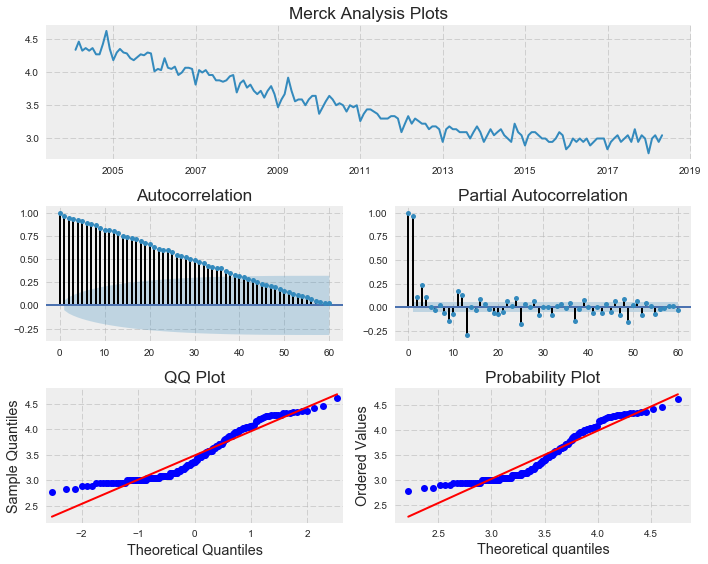

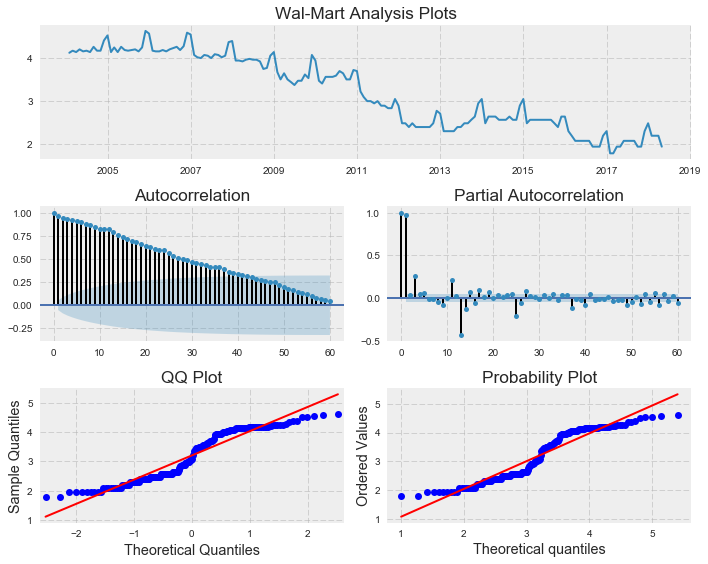

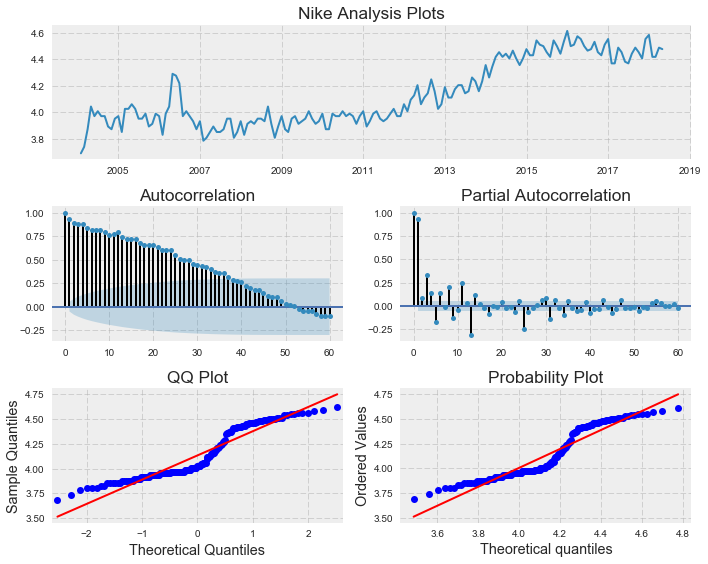

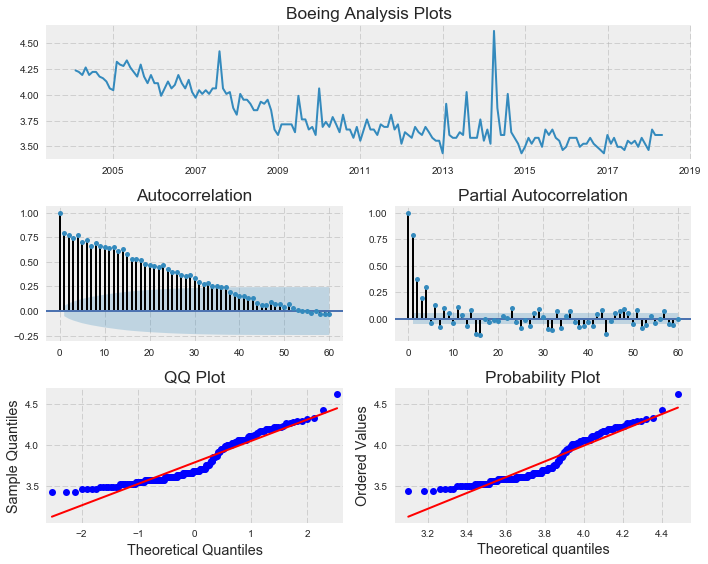

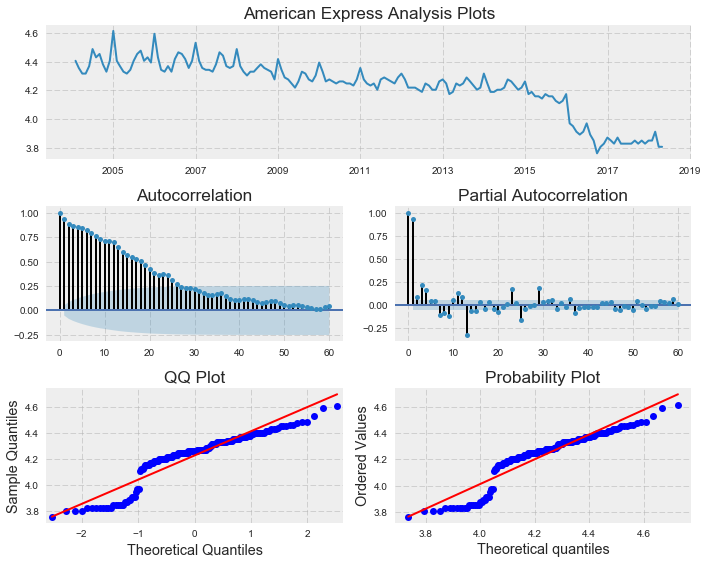

...

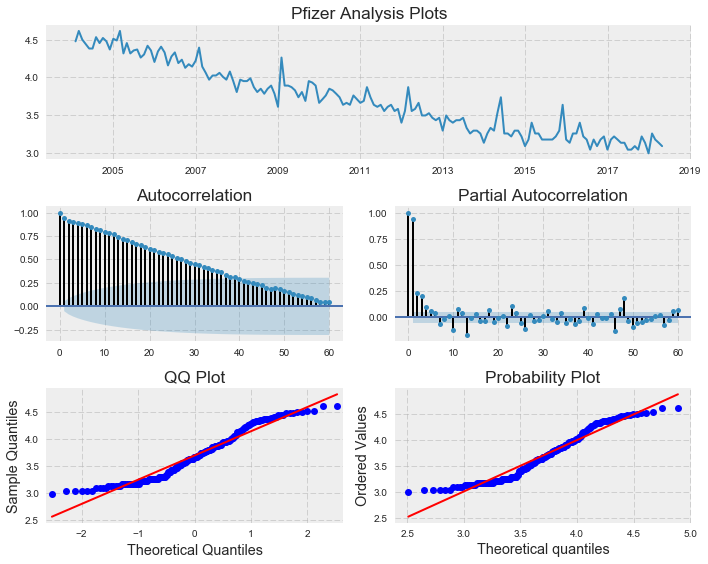

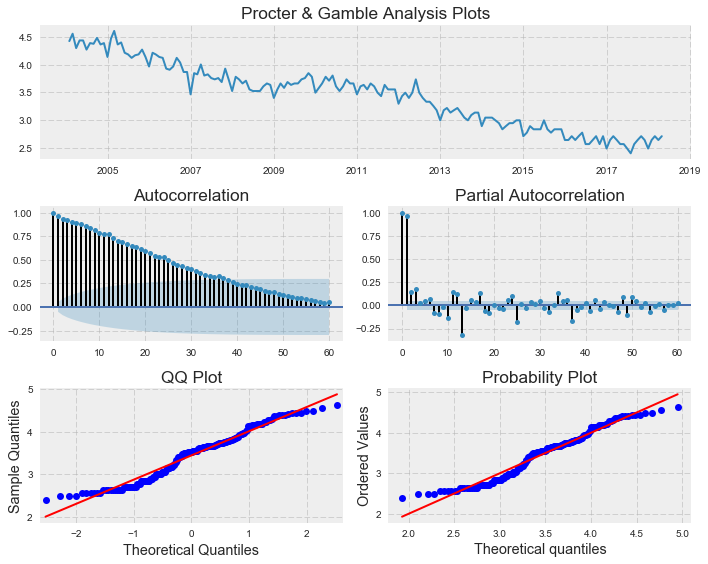

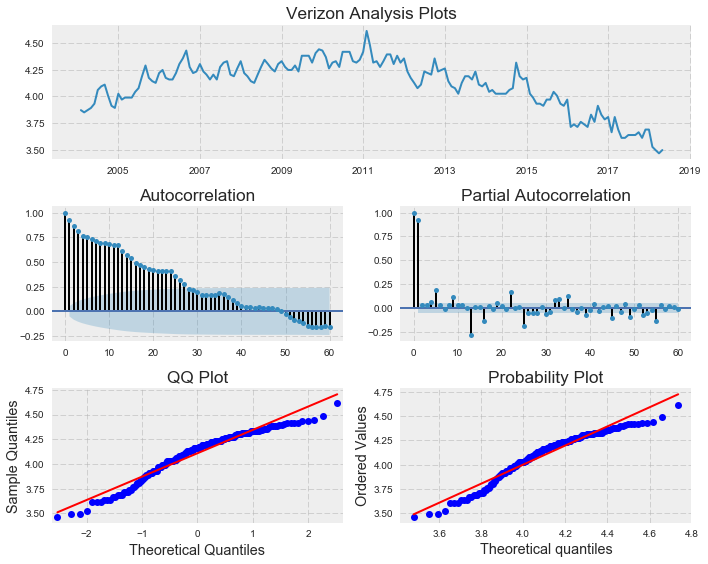

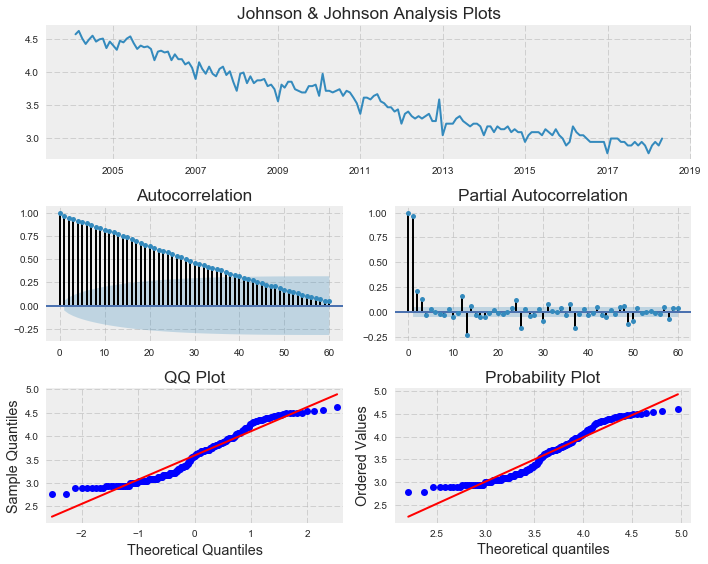

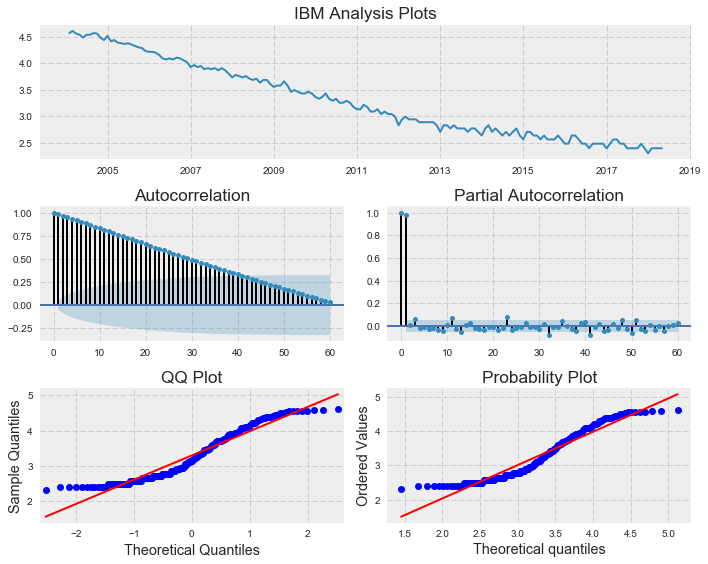

In [139]:
info_df_T = info_df.pivot(columns = 'Ticker', index = 'Date', values = 'SVI')

values = list(set(series.values()) - set(['s&p500']))
for i in values:
    tsplot(y = info_df_T[i], title = i, time_id = info_df_T.reset_index()['Date'], lags = 60)
    plt.show()

## Stationarity tests

We perform 2 stationarity tests: 


*   Augmented Dickey–Fuller test

    https://en.wikipedia.org/wiki/Augmented_Dickey%E2%80%93Fuller_test
    
    Testing for the null hypothesis that a unit root is present in a time series.
    
    http://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.adfuller.html
        
    
*   Kwiatkowski-Phillips-Schmidt-Shin test for stationarity
   
    https://en.wikipedia.org/wiki/KPSS_test
    
    Testing for the null hypothesis that an observable time series is stationary around a deterministic level or trend (i.e. trend-stationary) against the alternative of a unit root.
    
    http://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.kpss.html
    

In [7]:
''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x, regression = 'c')[1]

  
def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct')[1]


DF_df = info_df.drop(columns = ['Date','market_info']).groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
# DF_df['Reject'] = DF_df[0]>0.05
DF_df.round(decimals = 2)

C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1258: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1260: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)


SVI                       \
                        df_test_ct df_test_c df_test_nc   
Ticker                                                    
3M                            0.79      0.04       0.45   
American Express              0.59      0.94       0.16   
Apple                         0.82      0.33       0.98   
Boeing                        0.12      0.40       0.03   
Caterpillar                   0.15      0.32       0.63   
Chevron                       0.61      0.17       0.75   
Cisco                         0.09      0.48       0.01   
Coca-Cola                     0.98      0.54       0.00   
Disney                        0.19      0.97       0.28   
Dow Jones                     0.00      0.82       0.89   
Exxon Mobil                   0.05      0.98       0.15   
General Electric              1.00      0.10       0.16   
Goldman Sachs                 0.00      0.72       0.30   
Home Depot                    0.64      0.93       0.98   
IBM                           0.99      0.02       0.00   
Intel                         0.63      1.00       0.00   
JPMorgan Chase                0.00      0.00       0.75   
Johnson & Johnson             0.95      0.26       0.00   
McDonald's                    0.92      0.81       1.00   
Merck                         1.00      0.01       0.01   
Microsoft                     0.05      0.88       0.00   
Nike                          0.65      0.90       0.94   
Pfizer                        0.92      0.07       0.00   
Procter & Gamble              0.30      0.56       0.01   
Travelers Companies Inc       0.00      0.00       0.54   
United Technologies           0.81      0.17       0.03   
UnitedHealth                  0.83      0.76       0.81   
Verizon                       0.91      0.99       0.31   
Visa                          0.30      0.84       0.85   
Wal-Mart                      0.09      0.81       0.11   

                                                           
                        Kwiatkowski_Phillips_Schmidt_Shin  
Ticker                                                     
3M                                                   0.01  
American Express                                     0.02  
Apple                                                0.01  
Boeing                                               0.01  
Caterpillar                                          0.05  
Chevron                                              0.09  
Cisco                                                0.01  
Coca-Cola                                            0.01  
Disney                                               0.02  
Dow Jones                                            0.10  
Exxon Mobil                                          0.01  
General Electric                                     0.01  
Goldman Sachs                                        0.07  
Home Depot                                           0.04  
IBM                                                  0.01  
Intel                                                0.01  
JPMorgan Chase                                       0.06  
Johnson & Johnson                                    0.01  
McDonald's                                           0.02  
Merck                                                0.01  
Microsoft                                            0.10  
Nike                                                 0.01  
Pfizer                                               0.01  
Procter & Gamble                                     0.10  
Travelers Companies Inc                              0.02  
United Technologies                                  0.01  
UnitedHealth                                         0.02  
Verizon                                              0.01  
Visa                                                 0.02  
Wal-Mart                                             0.10

The series obtained are I(1), so we differenciate. 

In [9]:
# Differentiate all series
def diff_sort(x):
    x = x.sort_values(by = 'Date').drop(columns = 'Ticker')
    x = x.set_index(['Date'])
    x = x.diff(1).dropna()
    return x

info_df_diff = info_df.groupby(['Ticker']).apply(diff_sort).reset_index()

''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x,53, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x,53, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x,53, regression = 'c')[1]

  
def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct', lags = 52)[1]


DF_df = info_df_diff.drop(columns = ['Date','market_info']).groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
# DF_df['Reject'] = DF_df[0]>0.05
DF_df.round(decimals = 2)

C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1260: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)


SVI                       \
                        df_test_ct df_test_c df_test_nc   
Ticker                                                    
3M                            0.03      0.59       0.18   
American Express              0.01      0.08       0.02   
Apple                         0.00      0.00       0.00   
Boeing                        0.00      0.00       0.00   
Caterpillar                   0.52      0.08       0.01   
Chevron                       0.00      0.00       0.00   
Cisco                         0.70      0.16       0.23   
Coca-Cola                     0.00      0.00       0.01   
Disney                        0.34      0.08       0.06   
Dow Jones                     0.00      0.00       0.00   
Exxon Mobil                   0.00      0.00       0.00   
General Electric              0.01      0.14       0.05   
Goldman Sachs                 0.00      0.00       0.00   
Home Depot                    0.31      0.12       0.04   
IBM                           0.17      0.72       0.23   
Intel                         0.57      0.34       0.53   
JPMorgan Chase                0.00      0.00       0.00   
Johnson & Johnson             0.00      0.00       0.02   
McDonald's                    0.22      0.27       0.31   
Merck                         0.80      0.93       0.13   
Microsoft                     0.01      0.00       0.04   
Nike                          0.68      0.36       0.08   
Pfizer                        0.00      0.00       0.00   
Procter & Gamble              0.69      0.37       0.16   
Travelers Companies Inc       0.00      0.00       0.00   
United Technologies           0.00      0.00       0.00   
UnitedHealth                  0.00      0.00       0.00   
Verizon                       0.00      0.23       0.04   
Visa                          0.12      0.04       0.01   
Wal-Mart                      0.60      0.30       0.34   

                                                           
                        Kwiatkowski_Phillips_Schmidt_Shin  
Ticker                                                     
3M                                                   0.10  
American Express                                     0.07  
Apple                                                0.10  
Boeing                                               0.05  
Caterpillar                                          0.05  
Chevron                                              0.10  
Cisco                                                0.09  
Coca-Cola                                            0.04  
Disney                                               0.06  
Dow Jones                                            0.07  
Exxon Mobil                                          0.05  
General Electric                                     0.05  
Goldman Sachs                                        0.07  
Home Depot                                           0.10  
IBM                                                  0.05  
Intel                                                0.10  
JPMorgan Chase                                       0.04  
Johnson & Johnson                                    0.04  
McDonald's                                           0.10  
Merck                                                0.03  
Microsoft                                            0.05  
Nike                                                 0.10  
Pfizer                                               0.05  
Procter & Gamble                                     0.08  
Travelers Companies Inc                              0.04  
United Technologies                                  0.02  
UnitedHealth                                         0.05  
Verizon                                              0.04  
Visa                                                 0.10  
Wal-Mart                                             0.06

Now the series are I(0)

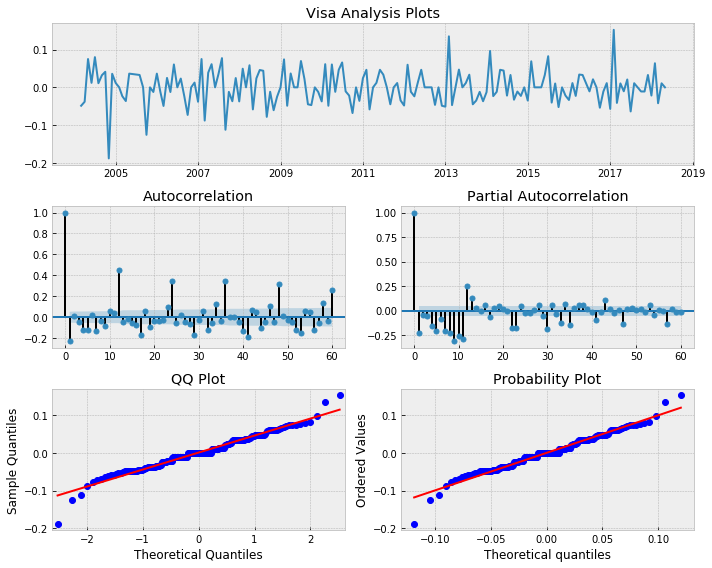

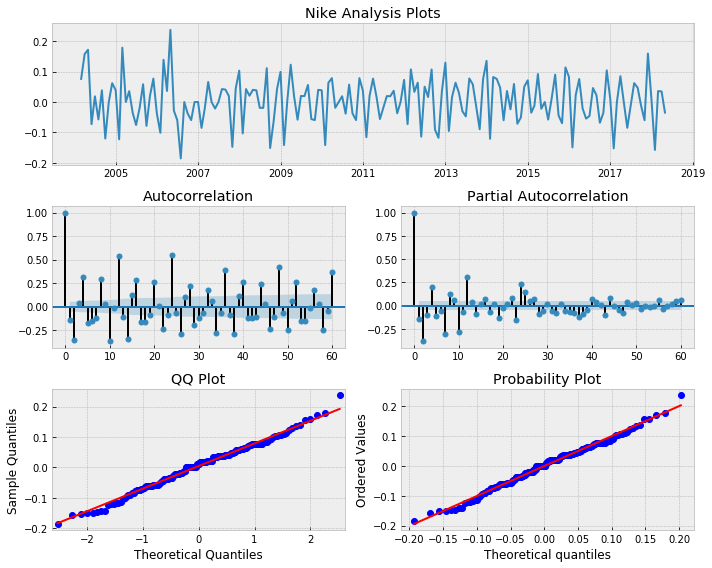

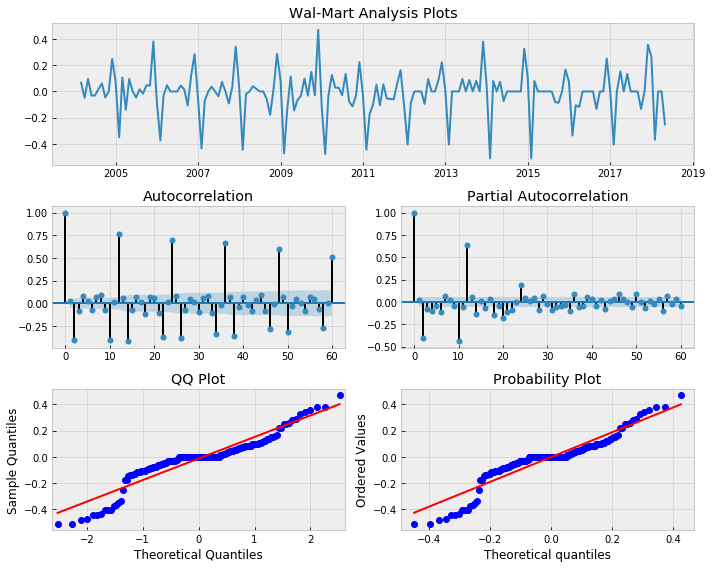

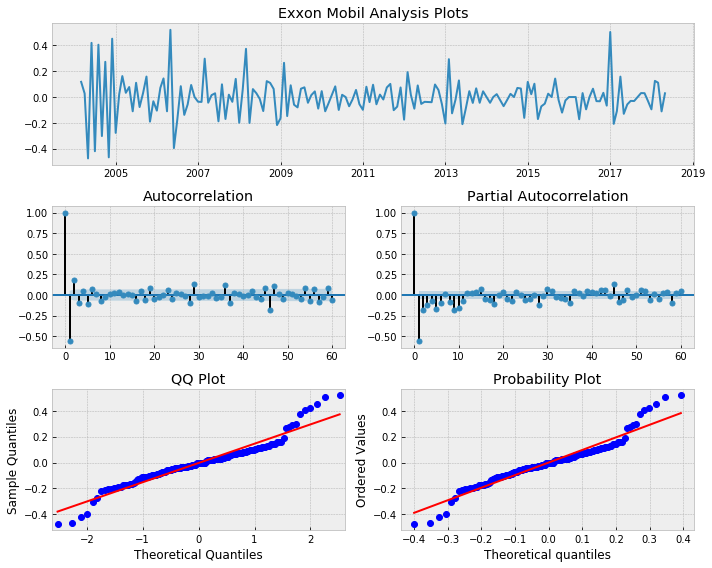

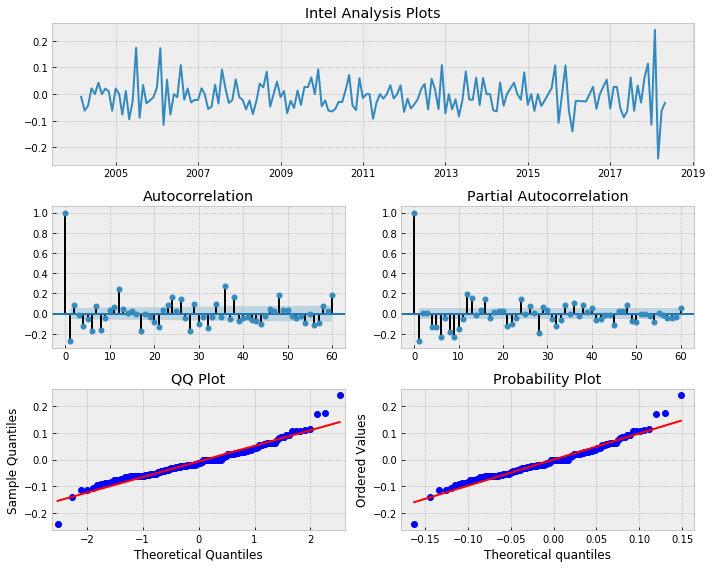

...

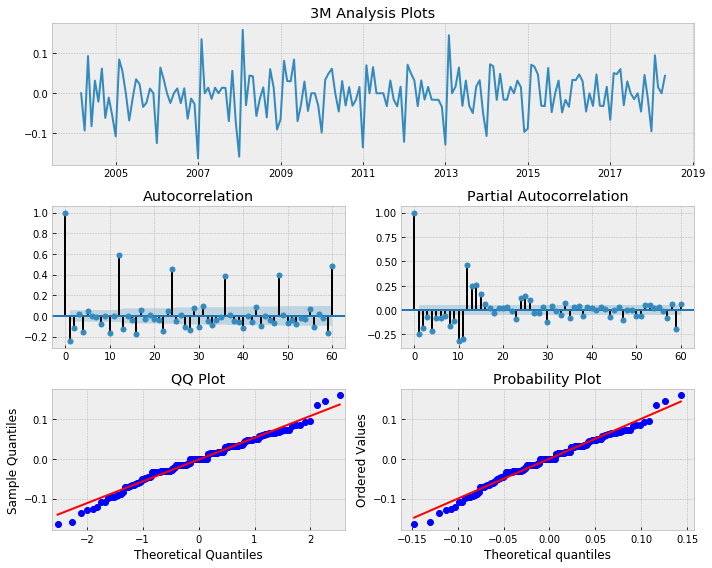

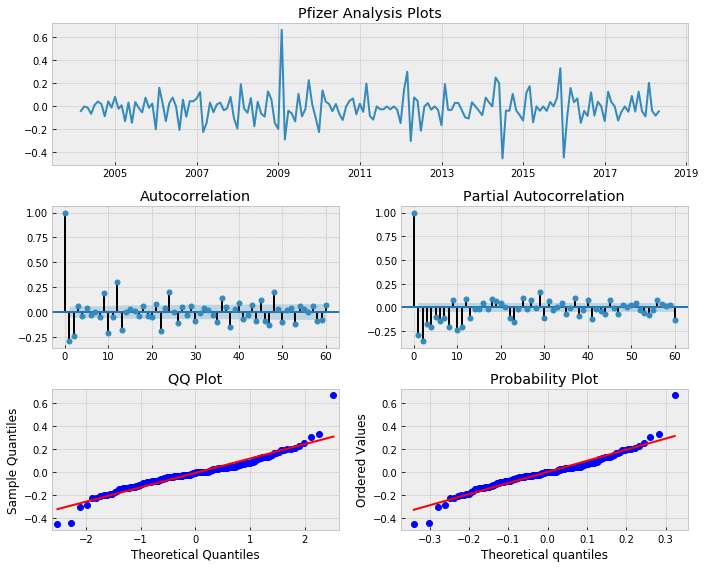

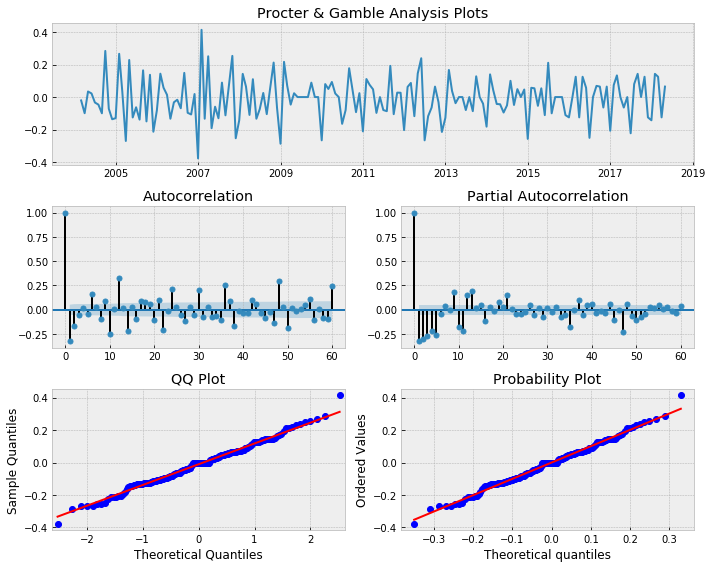

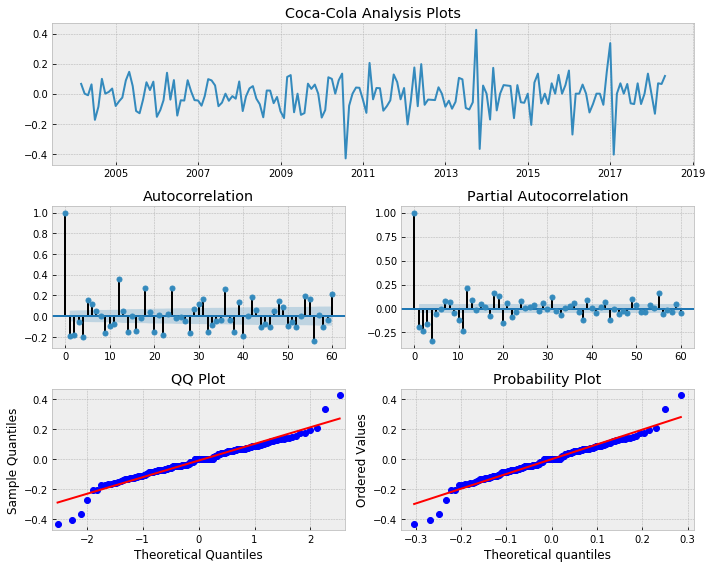

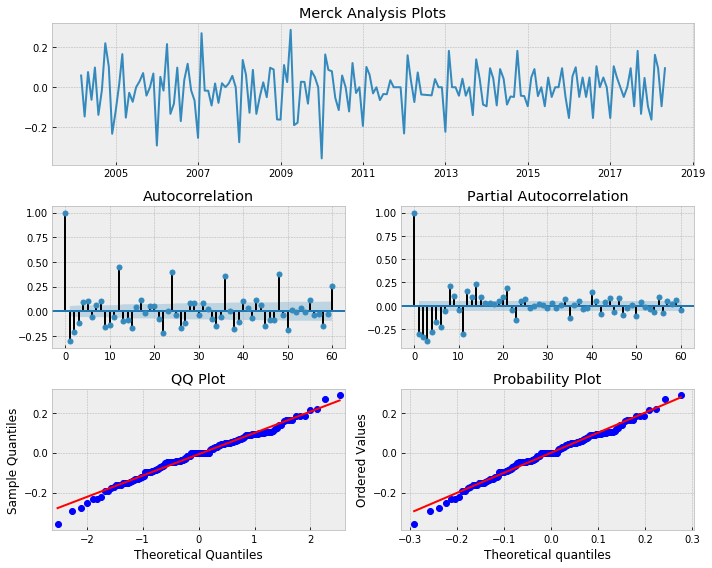

In [18]:
info_df_T = info_df_diff.pivot(columns = 'Ticker', index = 'Date', values = 'SVI')

values = list(set(series.values()) - set(['s&p500']))
for i in values:
    tsplot(y = info_df_T[i], title = i, time_id = info_df_T.reset_index()['Date'], lags = 60)
    plt.show()

In [10]:
info_df_diff.to_csv(path + 'month_not_adjusted_information_df_diff.csv')

# Stock information

First of all, we download the data. We will use the close prices for each stock, retreived from $\textbf{Yahoo Finance}$. The data frequency is of 5 days a week (only working days). The result is that we have aproximately 21 data points per month. 

In [22]:
# Fix dates to retreive
df = pd.read_csv(path + 'seasonal_information_df_diff.csv',infer_datetime_format=True, parse_dates=['Date'])

start_date = df.Date.min()
end_date = df.Date.max()

def get_stock(ticker):
    
    time.sleep(0.5)
    print(ticker)
    while True:
        try:
            r = pdr.get_data_yahoo(ticker, start=start_date, end=end_date)
            break
        except:
            print('Retry')
            pass
    return r
        
data = list(map(get_stock, series.keys()))

stock_df = pd.concat(data, keys=list(series.keys()), names=['Ticker', 'Date'])
stock_df = stock_df['Close']
stock_df = stock_df.unstack('Ticker')
# Save data
stock_df.to_csv(path + 'stock.csv')

PG
DIS
SPY
Retry
MSFT
GE
Retry
^DJI
CAT
VZ
MCD
NKE
Retry
CSCO
Retry
PFE
UTX
V
JPM
UNH
Retry
Retry
AAPL
GS
TRV
CVX
INTC
MRK
WMT
IBM
AXP
BA
XOM
JNJ
Retry
KO
HD
MMM


It is well known that prices are I(1).

In [16]:
prices = pd.read_csv(path + 'stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
list(prices.Date.unique()[-10:])

[numpy.datetime64('2018-03-16T00:00:00.000000000'),
 numpy.datetime64('2018-03-19T00:00:00.000000000'),
 numpy.datetime64('2018-03-20T00:00:00.000000000'),
 numpy.datetime64('2018-03-21T00:00:00.000000000'),
 numpy.datetime64('2018-03-22T00:00:00.000000000'),
 numpy.datetime64('2018-03-23T00:00:00.000000000'),
 numpy.datetime64('2018-03-26T00:00:00.000000000'),
 numpy.datetime64('2018-03-27T00:00:00.000000000'),
 numpy.datetime64('2018-03-28T00:00:00.000000000'),
 numpy.datetime64('2018-03-29T00:00:00.000000000')]

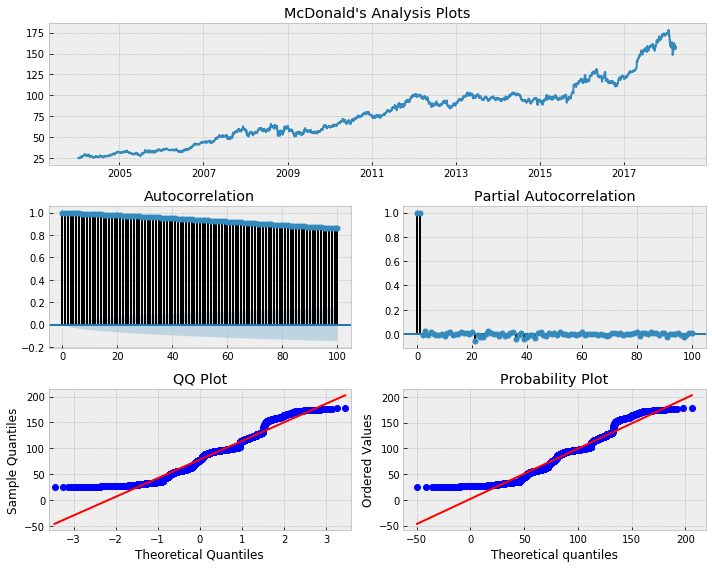

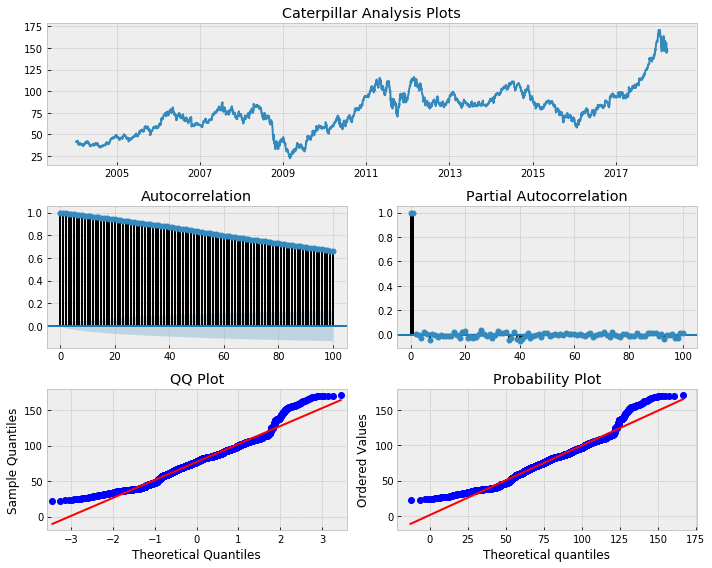

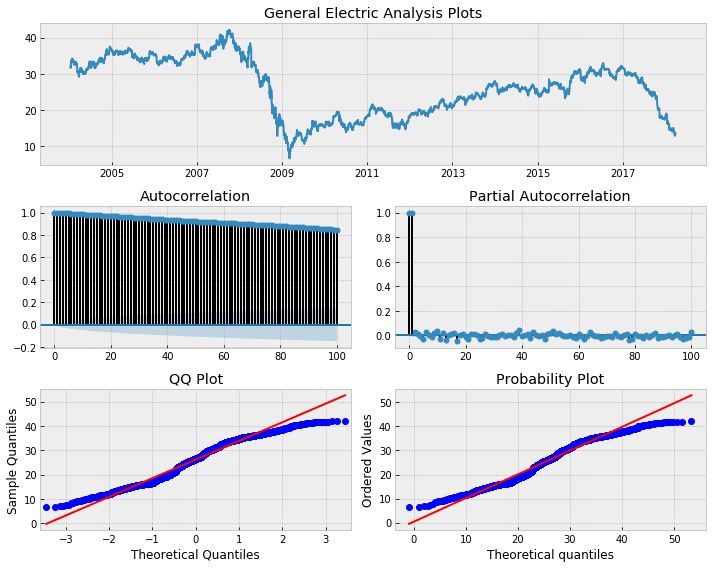

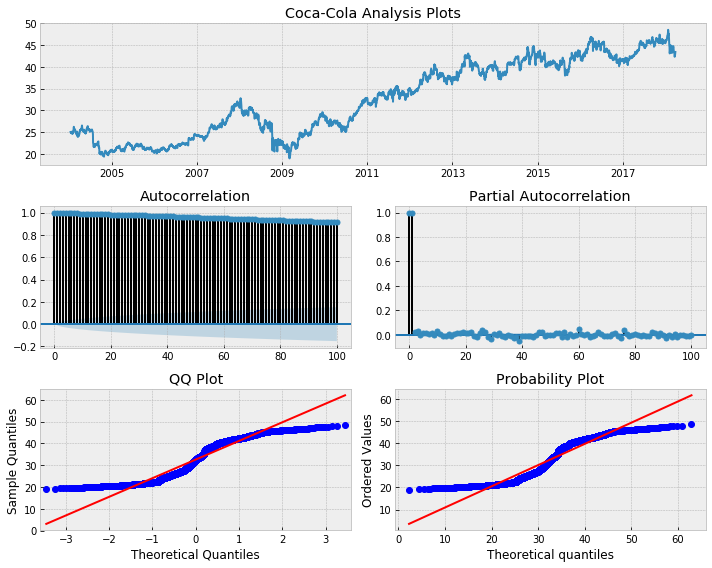

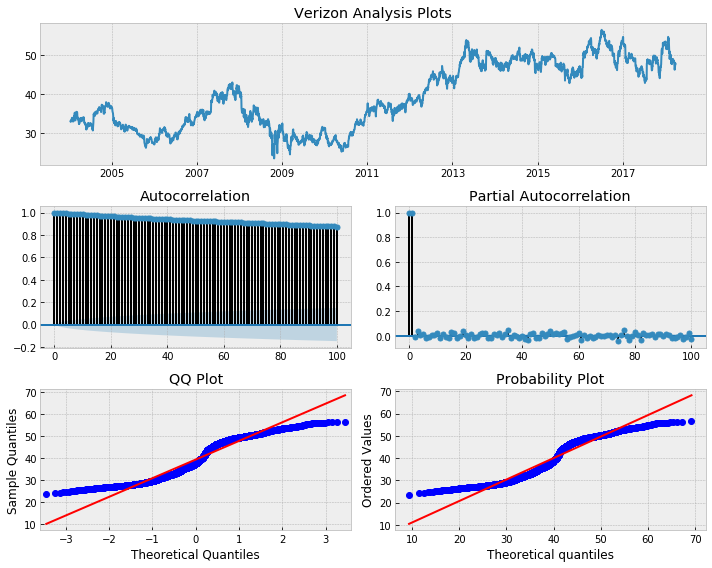

...

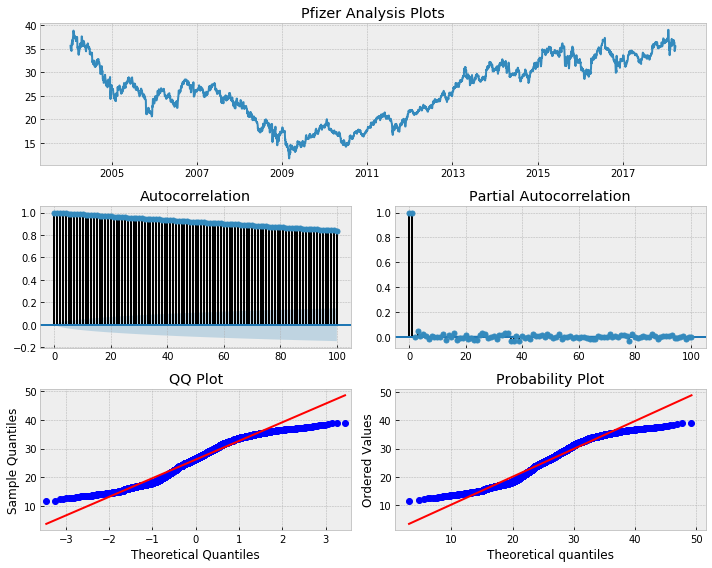

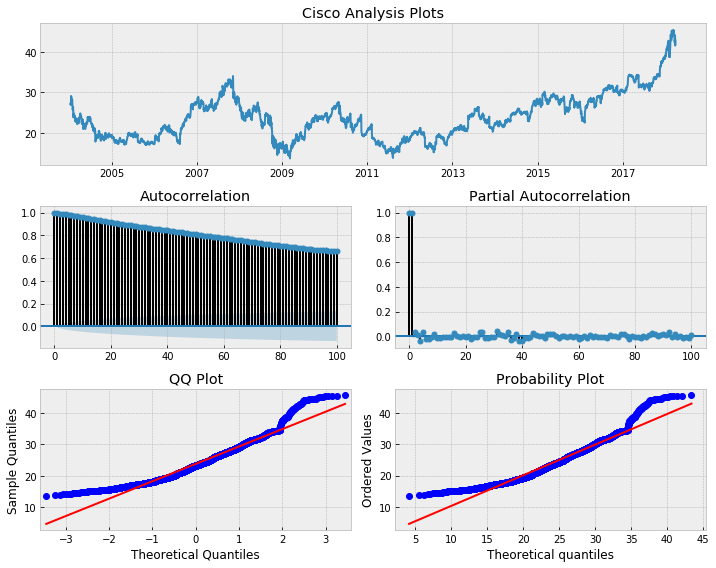

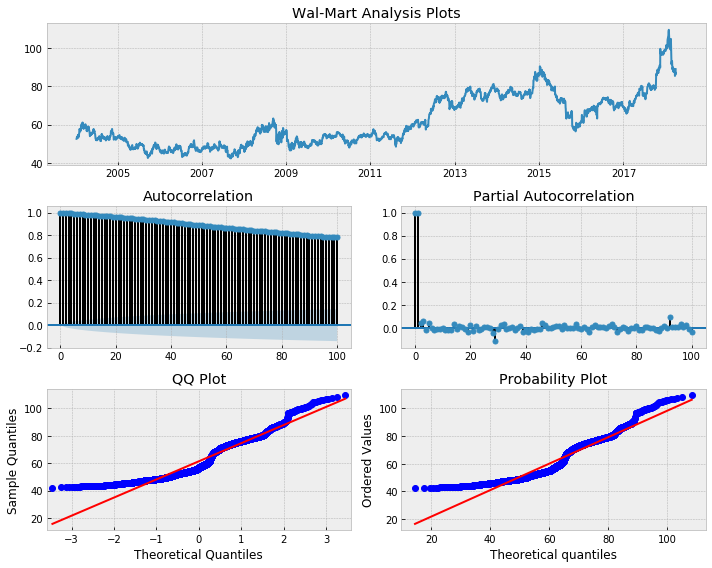

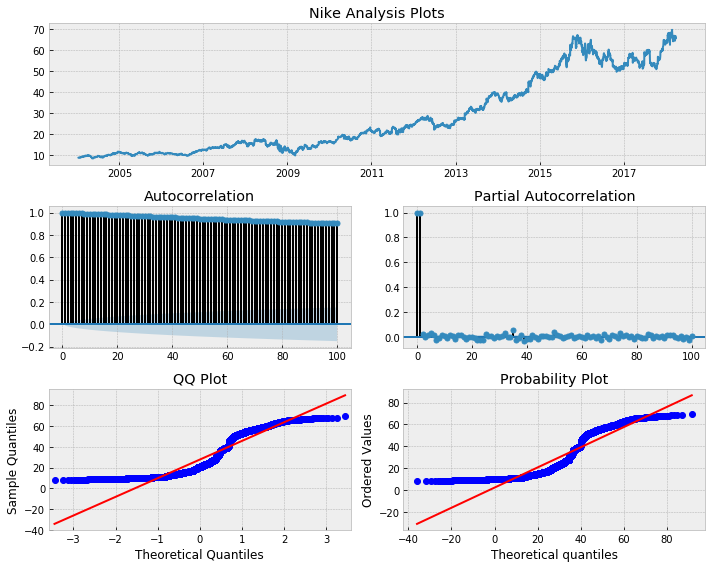

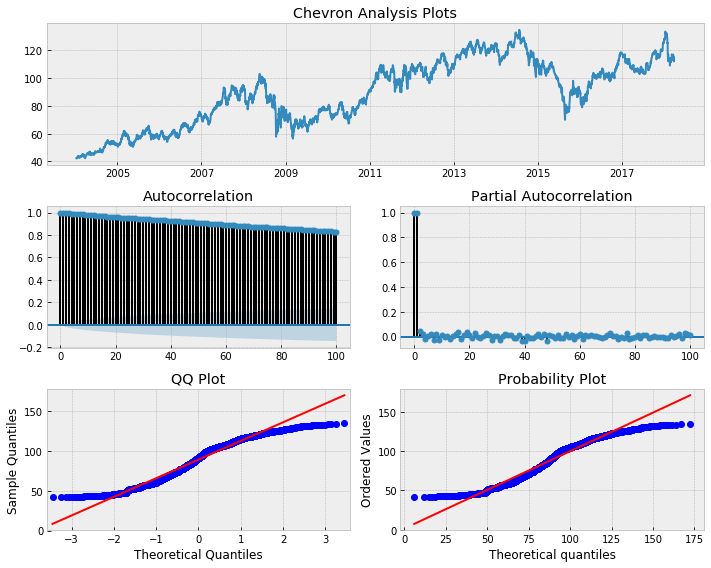

C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1821: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


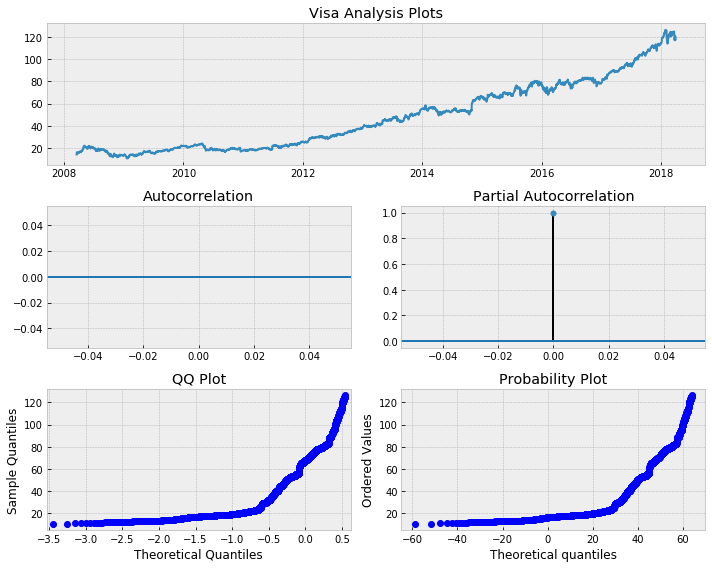

KeyError: 'SPY'

In [17]:
prices = pd.read_csv(path + 'stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
prices = prices.drop(columns = 'SPY')

for i in series.keys():
    tsplot(y = prices[i], title = series[i], time_id = prices['Date'], lags = 100)
    plt.show()

## Realized Volatility

Realized volatility is one of the most popular measures of historical
volatility in the literature at present due to its accuracy
and model-free nature (Andersen et al., 2001a,b https://www.sciencedirect.com/science/article/pii/S0304405X01000551 https://www.tandfonline.com/doi/abs/10.1198/016214501750332965; Barndorff-Nielsen
and Shephard, 2002https://rss.onlinelibrary.wiley.com/doi/full/10.1111/1467-9868.00336 ; inter alia). 

In the calculation of realized volatilities
for our series we follow the methodology of Andersen et al.
(2001a). In particular, we calculate logarithmic returns for all our dataset. In particular, we calculate daily logarithmic returns
from our stock price data. The returns are filtered
by taking the residuals from a $MA(1)$ model in order to remove
the typically found negative serial correlation. Consistent
with the findings in Andersen et al. (2001a), all estimated moving
average coefficients are negative or not significant in our data. We then calculate
weekly realized volatilities, by summing squared returns for each
month. The realized volatility for month t is given by
\begin{align}
r_{t,i} = p_{t,i} - p_{t-1,i} \\
RV_t = \log\left[\sum^N_{i=1}r^2_{t,i}\right]
\end{align}

In [11]:
# Read data 
STK_df = pd.read_csv(path + 'stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])

# Returns
STK_df[list(series.keys())] = STK_df[list(series.keys())]
STK_df[list(series.keys())] = STK_df[list(series.keys())].diff(1).dropna()

# Stack dataframe
STK_df = STK_df.set_index('Date').stack().reset_index()
STK_df.columns = ['Date','Ticker','Price']
STK_df = STK_df.set_index('Date')

# Filter by taking residuals of MA(1)
RV_df = pd.DataFrame()
parameters = pd.DataFrame()

for t, df in STK_df.groupby('Ticker'):
    
    model = am.ARIMA(df.drop(columns = 'Ticker'),
                     order = (0,0,1))
    result = model.fit(trend = 'c')
    # Keep residuals
    df['RV'] = result.resid
    RV_df = pd.concat([RV_df, df], axis=0)
    # Get model coeficients
    df_aux = pd.DataFrame([[t, result.params[1], result.pvalues[1]]], columns = ['Ticker','Coef','Pvalue'])
    parameters = pd.concat([parameters, df_aux])
    
RV_df = RV_df.reset_index()
RV_df = RV_df.drop(columns = 'Price')

# Calculate the 1st day of next month
def next_1_day_month(x):
    x = x.to_pydatetime()
    if x.month != 12:
        nextmonthdate = x.replace(day = 1).replace(month=x.month+1)
    else:
        nextmonthdate = x.replace(day = 1).replace(year=x.year+1, month=1)
        
    nextmonthdate = nextmonthdate - datetime.timedelta(days=1)

    return nextmonthdate

def next_sunday(x):
    x = x.to_pydatetime()
    idx = 7- (x.weekday() + 1)%7    
    
    return x + datetime.timedelta(idx)

RV_df['Date'] = RV_df.Date.map(next_1_day_month)

# Filter dates without data
d1 = date(2005,1,1)
d2 = date(2018,4,1)
RV_df = RV_df.query('Date > @d1 & Date < @d2')
RV_df = RV_df.set_index('Date')

# Calculate implied volatility for each period
# RV_df = RV_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x**2)/x.shape[0]).reset_index()
RV_df = RV_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x**2)).reset_index()
RV_df['RV'] = np.log(RV_df['RV'])
RV_df

C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:646: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if issubdtype(paramsdtype, float):
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:650: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  elif issubdtype(paramsdtype, complex):
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:577: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if issubdtyp

,Date,Ticker,RV
0,2008-03-31,AAPL,0.628235
1,2008-03-31,AXP,3.271481
2,2008-03-31,BA,2.295004
3,2008-03-31,CAT,1.954231
4,2008-03-31,CSCO,0.802403
5,2008-03-31,CVX,1.386141
6,2008-03-31,DIS,-0.004409
7,2008-03-31,GE,1.379927
8,2008-03-31,GS,5.571455
9,2008-03-31,HD,1.405683


In [12]:
parameters

,Ticker,Coef,Pvalue
0,AAPL,0.022557,2.757361e-01
0,AXP,-0.032954,1.114356e-01
0,BA,0.005247,8.161807e-01
0,CAT,0.005337,7.921444e-01
0,CSCO,-0.030267,1.474866e-01
0,CVX,-0.059200,4.281851e-03
0,DIS,-0.011861,5.646949e-01
0,GE,-0.026319,2.079888e-01
0,GS,-0.036154,8.080090e-02
0,HD,0.001103,9.598348e-01


Check for stationarity

In [24]:
''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x, regression = 'c')[1]

def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct')[1]

DF_df = RV_df
DF_df = DF_df.drop(columns = 'Date').groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
DF_df.round(decimals = 2)

C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1260: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1258: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)


RV                                                       
       df_test_ct df_test_c df_test_nc Kwiatkowski_Phillips_Schmidt_Shin
Ticker                                                                  
AAPL         0.09      0.72       0.84                              0.10
AXP          0.00      0.00       0.32                              0.08
BA           0.06      0.56       0.82                              0.03
CAT          0.30      0.09       0.76                              0.10
CSCO         0.41      0.10       0.23                              0.03
CVX          0.00      0.00       0.54                              0.10
DIS          0.00      0.00       0.70                              0.10
GE           0.00      0.00       0.02                              0.02
GS           0.40      0.11       0.54                              0.01
HD           0.00      0.85       0.84                              0.07
IBM          0.01      0.00       0.65                              0.10
INTC         0.37      0.21       0.45                              0.05
JNJ          0.00      0.07       0.58                              0.08
JPM          0.11      0.02       0.48                              0.02
KO           0.01      0.00       0.07                              0.10
MCD          0.01      0.06       0.69                              0.09
MMM          0.11      0.09       0.75                              0.05
MRK          0.00      0.01       0.34                              0.02
MSFT         0.39      0.48       0.68                              0.04
NKE          0.31      0.68       0.70                              0.10
PFE          0.00      0.00       0.03                              0.10
PG           0.00      0.01       0.45                              0.10
SPY          0.00      0.00       0.60                              0.10
TRV          0.02      0.03       0.48                              0.05
UNH          0.46      0.76       0.86                              0.05
UTX          0.00      0.00       0.63                              0.10
V            0.05      0.86       0.82                              0.08
VZ           0.00      0.00       0.33                              0.10
WMT          0.00      0.05       0.54                              0.10
XOM          0.00      0.00       0.36                              0.10
^DJI         0.00      0.00       0.76                              0.10

Realised Volatility is I(0)

At last, we calculate market and firm log-returns to control for it in the model. 

In [18]:
# Read data 
series_ret_df = pd.read_csv(path + 'stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
series_ret_df = series_ret_df.drop(columns = 'SPY')
series_ret_df = series_ret_df.set_index('Date').stack().reset_index()
series_ret_df.columns = ['Date', 'Ticker', 'ret']

# Returns
series_ret_df['ret'] = series_ret_df.groupby('Ticker')['ret'].apply(lambda x: np.log(x))
series_ret_df['ret'] = series_ret_df.groupby('Ticker')['ret'].diff(1)

# Aggregate periods
series_ret_df['Date'] = series_ret_df.Date.map(next_1_day_month)
series_ret_df = series_ret_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x)).reset_index()

series_ret_df['ret_1'] = series_ret_df.groupby('Ticker')['ret'].shift(1)

# Read data 
market_ret_df = pd.read_csv(path + 'stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
# Only market data
market_ret_df = market_ret_df[['Date','SPY']]
# Logarithmic returns
market_ret_df['SPY'] = np.log(market_ret_df['SPY'])
market_ret_df['SPY'] = market_ret_df['SPY'].diff(1)

# Aggregate periods
market_ret_df['Date'] = market_ret_df.Date.map(next_1_day_month)
market_ret_df = market_ret_df.groupby(['Date']).agg(lambda x: np.sum(x)).reset_index()

market_ret_df['SPY_1'] = market_ret_df['SPY'].shift(1)
# Drop nan
market_ret_df = market_ret_df.dropna()
market_ret_df.head()

,Date,SPY,SPY_1
1,2004-02-29,0.013479,0.002294
2,2004-03-31,-0.016834,0.013479
3,2004-04-30,-0.019103,-0.016834
4,2004-05-31,0.016978,-0.019103
5,2004-06-30,0.014689,0.016978


We use the following regression in order to study the relationship
between realized volatility and information demand while
controlling for the effect of market returns:
\begin{equation}
RV_t = \omega + \gamma\pi_t + \delta\phi_t +  \lambda\nu_t + \theta\nu_{t-1} + \psi RV_{t-1} + \epsilon_t
\end{equation}

where $\omega$ is the constant, $\pi_t$ is idiosyncratic information demand at
time $t$, $\phi_t$ is market-related information demand at time t, $\nu_t$ is the market return at time t and $\epsilon_t$ are the
errors.

In [19]:
# info_df = pd.read_csv(path + 'month_up_information_df_seasonal.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
# info_df = pd.read_csv(path + 'month_up_information_df_seasonal_diff.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
info_df = pd.read_csv(path + 'month_not_adjusted_information_df_diff.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')

inv_series = dict([(i[1],i[0]) for i in series.items()])
info_df['Ticker'] = info_df['Ticker'].map(inv_series)

# Save market's realized volatility 
s = 'SPY'
rv_df = RV_df.query('Ticker != @s')
m_rv_df = RV_df.query('Ticker == @s').drop(columns = ['Ticker']).rename(columns = {'RV':'market_RV'})
returns_df = pd.merge(rv_df, m_rv_df, on='Date')

# Save ideosincratic return
info_df = pd.merge(info_df, series_ret_df)

# Merge dataframes
df = pd.merge(returns_df, info_df)
df = pd.merge(df,market_ret_df)

# # Create Variables
df['RV_1'] = df.groupby('Ticker')['RV'].shift(1)
df['market_RV_1'] = df.groupby('Ticker')['market_RV'].shift(1)

df = df.dropna()
df.head()
df.to_csv(path + 'regresion.csv')

In [4]:
df = pd.read_csv(path + 'regresion.csv', infer_datetime_format=True, parse_dates=['Date'])
df = df[(df.Date.dt.year > 2011) & (df.Date.dt.year < 2018)]

pvalues = pd.DataFrame()
parameters = pd.DataFrame()
residuals = pd.DataFrame()
r_squared_adj = dict()
aic_all = dict()

for t, data in df.groupby('Ticker'):
    
    var = ['SVI','market_info','SPY','SPY_1','RV_1']
#     var = ['SVI','market_info','SPY','RV_1']
    
    y = data['RV']
    X = sm.add_constant(data[var])
    model = sm.GLS(y, X)
    result = model.fit()
#     result = result.get_robustcov_results(cov_type = 'HAC', maxlags = int(data.shape[0]**(1/4)))
    # Get model coeficients
    
    df_coef = pd.DataFrame([[t] + list(result.params)], columns = ['Ticker'] + ['const'] + var)
    parameters = pd.concat([parameters, df_coef])
    
    df_aux = pd.DataFrame([[t] + list(result.pvalues)], columns = ['Ticker'] + ['const'] + var)
    pvalues = pd.concat([pvalues, df_aux])
    
    # Get residuals
    df_resid = pd.DataFrame({'resid':result.resid, 
                             'Date': data['Date']})
    df_resid['Ticker'] = t
    residuals = pd.concat([residuals, df_resid])
    
    # Get r^2
    r_squared_adj[t] = result.rsquared
    aic_all[t] = result.aic
    

print(parameters.sort_values(by = ['SVI']))
pvalues.sort_values(by = ['SVI'])

  Ticker     const       SVI  market_info        SPY     SPY_1      RV_1
0    MMM  1.967621 -2.859162     1.294742  -8.358565 -3.439096  0.450083
0   MSFT  1.161899 -2.596966     0.871343  -6.144548 -5.225476  0.412497
0    CAT  2.601822 -1.486118     0.600684  -3.040953 -3.074176  0.250380
0    JNJ  0.977899 -1.415021     1.815244  -8.690813 -0.566803  0.622012
0    CVX  1.607613 -0.741526     0.701393  -5.351967 -0.696142  0.532519
0    AXP  2.165793 -0.626779     1.048636  -7.159035 -5.703143  0.205775
0     VZ  1.159920  0.025546     1.017499  -2.561751 -2.767578  0.218050
0    MRK  1.254141  0.066095     1.261959  -6.963602 -1.109889  0.345288
0    TRV  1.730998  0.074146     0.676784  -9.335494 -1.941497  0.392905
0     PG  1.828346  0.092793     0.930534  -3.456646 -3.919113  0.168787
0      V  1.091965  0.098197     1.482875  -5.461640 -3.103051  0.545935
0    UNH  1.166099  0.101432     1.269069  -3.419822 -2.100734  0.662763
0   AAPL  2.861082  0.320130     0.479173  -6.81412

,Ticker,const,SVI,market_info,SPY,SPY_1,RV_1
0,UTX,8.218721e-09,0.000024,0.121455,0.167509,0.047067,2.193881e-03
0,GE,4.765945e-05,0.010901,0.789138,0.122814,0.002817,3.314196e-01
0,^DJI,6.430334e-09,0.017906,0.713353,0.000849,0.132432,4.879014e-02
0,MCD,1.945369e-07,0.018002,0.334879,0.047358,0.069386,3.186556e-03
0,PFE,2.977570e-02,0.052673,0.016665,0.452075,0.959762,4.870844e-07
0,MMM,1.028263e-06,0.064046,0.013362,0.006373,0.278772,3.227664e-05
0,JPM,2.018794e-03,0.069511,0.000009,0.001416,0.628212,3.543801e-07
0,INTC,1.491078e-07,0.070219,0.893017,0.009119,0.031563,6.004061e-03
0,MSFT,1.572692e-06,0.072183,0.120946,0.062274,0.123593,2.175972e-04
0,JNJ,1.625845e-04,0.078311,0.000386,0.002123,0.847389,2.731647e-09


In [5]:
cols = list(parameters.columns)
cols.remove('Ticker')
df_all = pd.merge(parameters, pvalues, on='Ticker').set_index('Ticker')

def preparar_tabla(x):
    for c in cols:
        if x[c+'_y'] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{***}$"
        elif x[c+'_y'] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{**}$"
        elif x[c+'_y'] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c+'_x']))
            
    return(x)

df_all = df_all.apply(preparar_tabla, axis = 1)[cols].reset_index().round(decimals = 2)
df_all['R_sqr'] = df_all['Ticker'].map(r_squared_adj).round(decimals = 2)
df_all['AIC'] = df_all['Ticker'].map(aic_all).round(decimals = 2)
df_all

,Ticker,const,SVI,market_info,SPY,SPY_1,RV_1,R_sqr,AIC
0,AAPL,2.86$^{***}$,0.32,0.479,-6.81$^{**}$,-2.58,0.24$^{**}$,0.17,164.76
1,AXP,2.17$^{***}$,-0.627,1.05$^{**}$,-7.16$^{***}$,-5.7$^{**}$,0.206$^{*}$,0.28,130.38
2,BA,1.7$^{***}$,0.442,1.52$^{***}$,-6.1$^{**}$,-5.04$^{*}$,0.583$^{***}$,0.50,147.21
3,CAT,2.6$^{***}$,-1.49,0.601,-3.04,-3.07,0.25$^{**}$,0.15,131.59
4,CSCO,0.549$^{***}$,1.37,0.677,-5.04,-3.12,0.212,0.13,159.21
5,CVX,1.61$^{***}$,-0.742,0.701$^{**}$,-5.35$^{**}$,-0.696,0.533$^{***}$,0.43,96.02
6,DIS,0.936$^{***}$,1.16,1.61$^{***}$,-5.67$^{**}$,1.98,0.663$^{***}$,0.53,138.27
7,GE,0.431$^{***}$,3.32$^{**}$,0.135,-4.46,-9.02$^{***}$,0.11,0.26,148.45
8,GS,2.51$^{***}$,0.504,1.4$^{***}$,-5.97$^{**}$,0.0452,0.469$^{***}$,0.34,121.52
9,HD,1.15$^{***}$,1.15,0.958$^{**}$,-11.8$^{***}$,-0.902,0.661$^{***}$,0.58,133.97


In [6]:
df_1 = df_all[['Ticker','R_sqr','AIC']]

In [7]:
df_all.to_csv(path + 'bad_ARDL_parameters.csv')

Finally, basing ourselves on AIC, and significance of variables we estimate the model (idiosyncratic information demand is not relevant). 

\begin{equation}
RV_t = \omega + \delta\phi_t +  \lambda\nu_t + \psi RV_{t-1} + \epsilon_t
\end{equation}

where $\omega$ is the constant, $\phi_t$ is market-related information demand at time t, $\nu_t$ is the market return at time t and $\epsilon_t$ are the
errors.

In [35]:
df = pd.read_csv(path + 'regresion.csv', infer_datetime_format=True, parse_dates=['Date'])
df = df[(df.Date.dt.year > 2011) & (df.Date.dt.year <= 2018)]

pvalues = pd.DataFrame()
parameters = pd.DataFrame()
residuals = pd.DataFrame()
models = dict()
r_squared_adj = dict()
aic_all = dict()

for t, data in df.groupby('Ticker'):
    
    var = ['market_info','SPY','RV_1']
#     var = ['SVI','market_info','SPY','RV_1']
    
    y = data['RV']
    X = sm.add_constant(data[var])
    model = sm.GLS(y, X)
    result = model.fit()
#     result = result.get_robustcov_results(cov_type = 'HAC', maxlags = int(data.shape[0]**(1/4)))
    # Get model coeficients
    
    df_coef = pd.DataFrame([[t] + list(result.params)], columns = ['Ticker'] + ['const'] + var)
    parameters = pd.concat([parameters, df_coef])
    
    df_aux = pd.DataFrame([[t] + list(result.pvalues)], columns = ['Ticker'] + ['const'] + var)
    pvalues = pd.concat([pvalues, df_aux])
    
    # Get residuals
    df_resid = pd.DataFrame({'resid':result.resid, 
                             'Date': data['Date']})
    df_resid['Ticker'] = t
    residuals = pd.concat([residuals, df_resid])
    
    # Get models
    models[t] = result
    
    r_squared_adj[t] = result.rsquared_adj
    aic_all[t] = result.aic
    
    

print(parameters.sort_values(by = ['market_info']))
pvalues.sort_values(by = ['market_info'])

  Ticker     const  market_info        SPY      RV_1
0   INTC  0.605680     0.313142  -6.342601  0.528904
0    NKE  0.972569     0.315702 -12.470067  0.515361
0    MCD  1.659845     0.694894  -4.965765  0.437371
0   AAPL  2.614044     0.708447  -7.170707  0.310453
0     GE  0.309020     0.756839  -1.582938  0.110503
0    WMT  1.661986     0.825375  -2.906053  0.288369
0    UTX  1.900674     0.914585  -3.375855  0.388798
0   MSFT  0.933812     0.923621  -6.937701  0.549485
0    CVX  1.490394     0.929409  -4.652749  0.568337
0    IBM  4.208519     0.930878  -0.870924 -0.012875
0    CAT  1.829968     0.937715  -3.666593  0.480870
0    TRV  1.561578     1.007427  -7.988615  0.457158
0     KO  0.644961     1.032280  -1.663090  0.181416
0    XOM  1.322287     1.120794  -4.521001  0.510051
0     PG  1.718059     1.184358  -2.699637  0.205231
0    MMM  1.555008     1.293970  -7.919567  0.572772
0     HD  1.086203     1.295329 -10.353075  0.680795
0   CSCO  0.465016     1.296226  -5.372861  0.

,Ticker,const,market_info,SPY,RV_1
0,JPM,1.650968e-04,2.697062e-07,0.000022,1.910628e-09
0,GS,5.059602e-06,4.234512e-05,0.003303,6.740411e-07
0,^DJI,2.572947e-08,5.664824e-05,0.000032,1.151698e-04
0,DIS,4.731831e-05,8.837626e-05,0.025622,1.485089e-11
0,VZ,3.866092e-09,2.394804e-04,0.380257,2.834702e-02
0,V,8.562753e-05,2.776298e-04,0.044076,7.675722e-10
0,BA,8.485914e-04,3.086306e-04,0.134607,2.178585e-13
0,AXP,3.373960e-08,3.152299e-04,0.002207,1.338662e-03
0,JNJ,3.551883e-05,4.812016e-04,0.009671,1.340793e-10
0,HD,1.909086e-05,8.806739e-04,0.000064,9.201786e-14


We have to confirm that our especification is good, so that residuals are white noise. We can perform a Durbin-Watson and a Ljung-Box test for white noise.  

In [23]:
def Durbin_Watson(x):
    return(durbin_watson(x))

def Ljung_Box(x):
    return(np.mean(acorr_ljungbox(x, lags = int(5))[1]))

WN_df = residuals
WN_df = WN_df.drop(columns = 'Date').groupby('Ticker').aggregate([Durbin_Watson,Ljung_Box])
WN_df = WN_df['resid'].reset_index().sort_values(by = 'Ljung_Box')
WN_df['breusch_godfrey'] = WN_df['Ticker'].map(lambda x: acorr_breusch_godfrey(models[x])[1]).round(decimals = 2)
WN_df.sort_values(by = 'breusch_godfrey')

,Ticker,Durbin_Watson,Ljung_Box,breusch_godfrey
25,V,2.547358,0.011129,0.00
22,TRV,2.272349,0.230662,0.00
9,HD,2.691401,0.001908,0.01
10,IBM,2.011688,0.389698,0.01
15,MCD,2.322518,0.061651,0.01
19,NKE,2.331005,0.118114,0.01
23,UNH,2.520366,0.017958,0.02
12,JNJ,2.415270,0.030212,0.02
13,JPM,2.506942,0.020246,0.03
2,BA,2.443853,0.056404,0.03


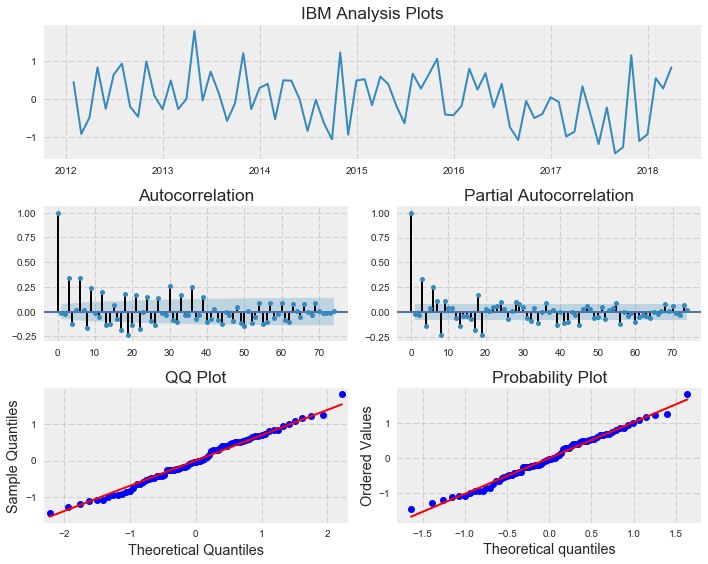

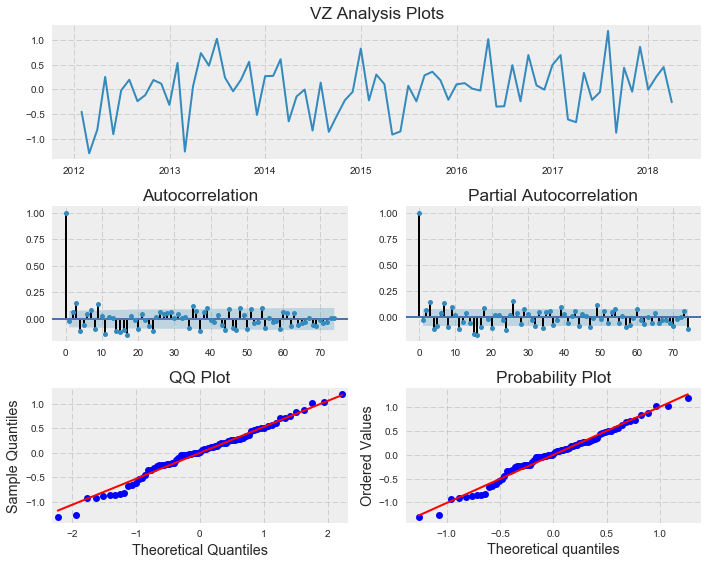

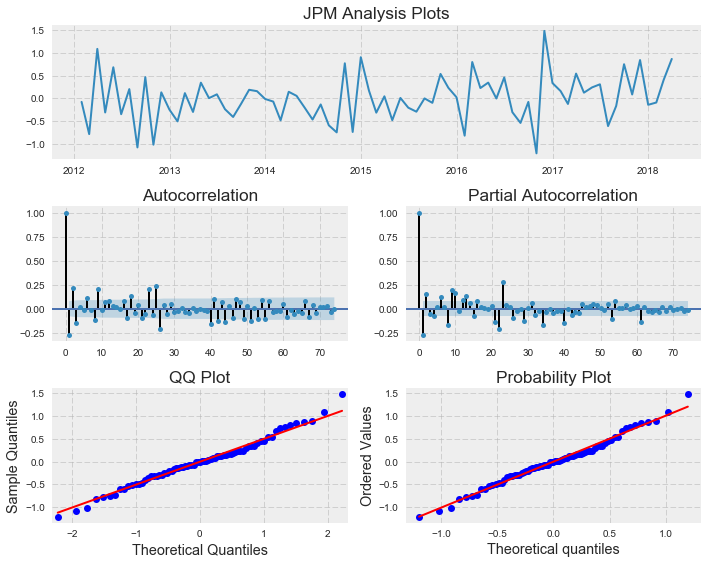

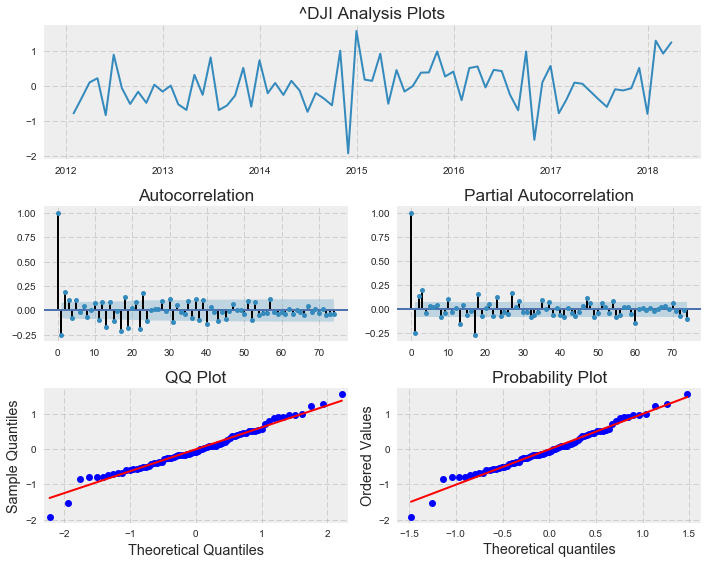

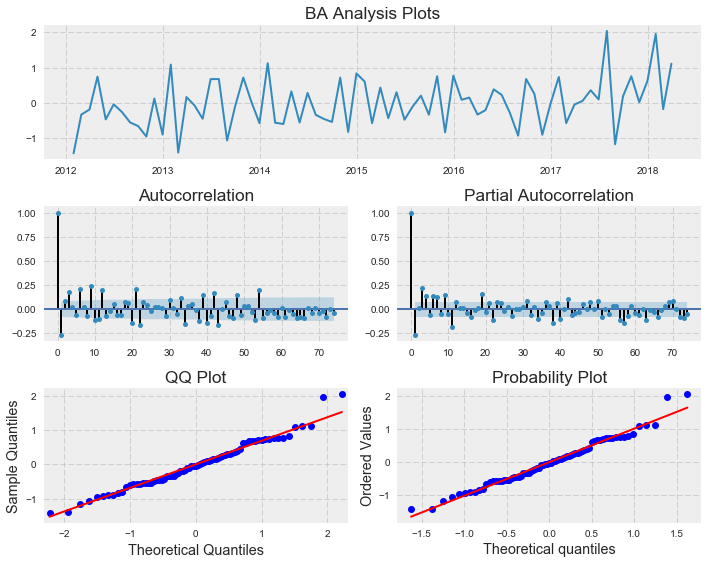

...

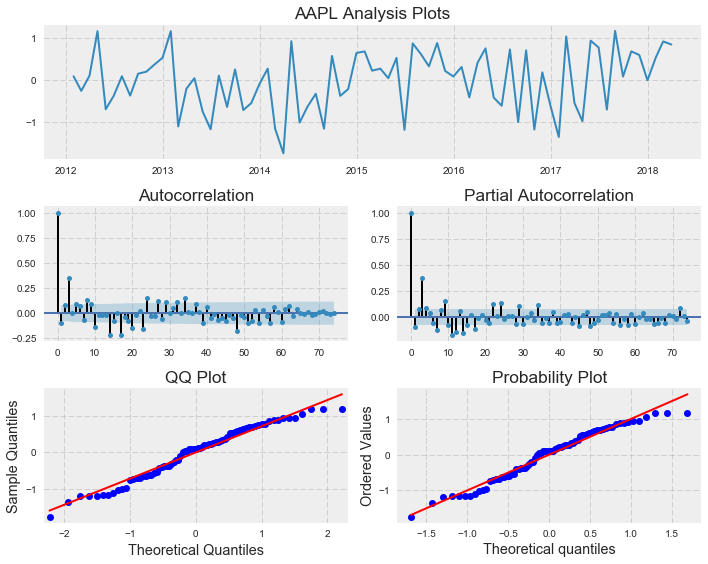

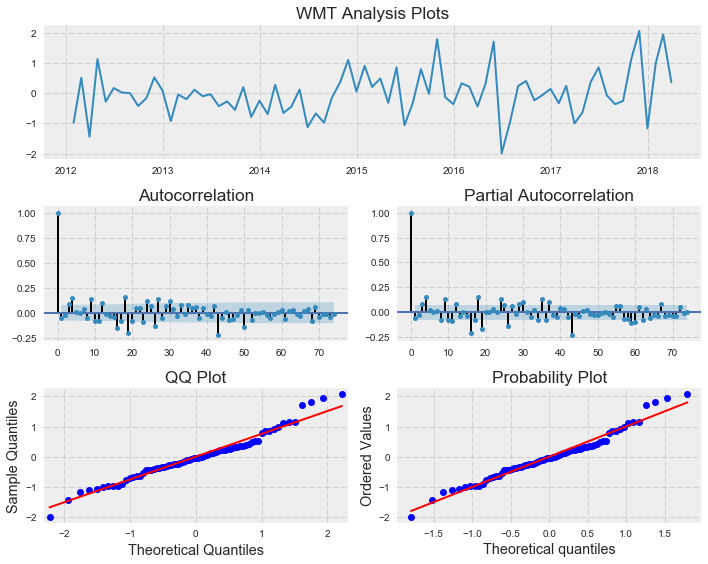

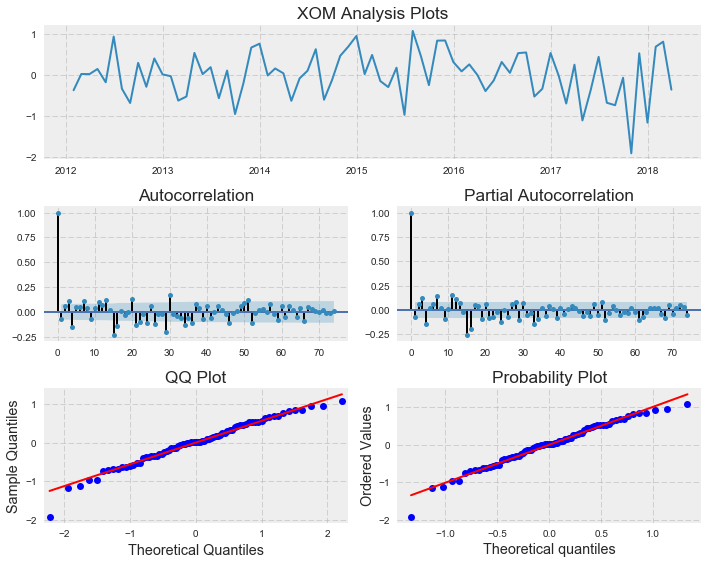

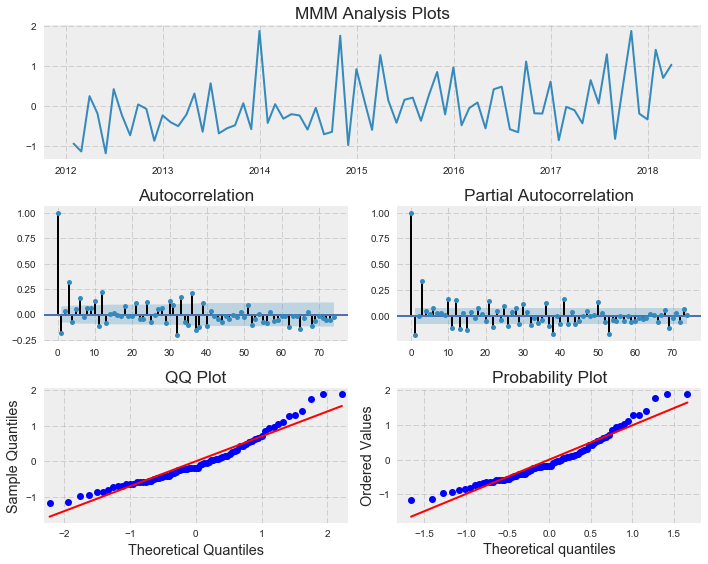

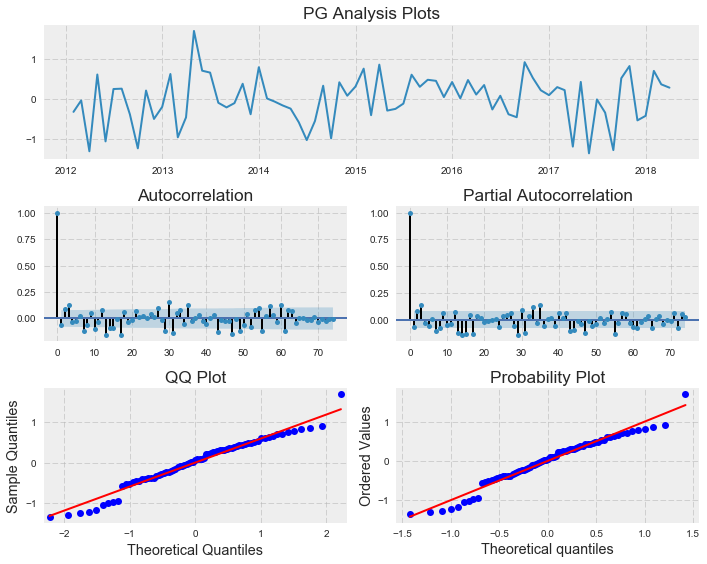

In [16]:
residuals_T = residuals.pivot(columns='Ticker', values='resid', index = 'Date').reset_index()

keys = list(set(series.keys()) - set(['SPY']))
for i in keys:
    tsplot(y = residuals_T[i], title = i, time_id = residuals_T['Date'])
    plt.show()

In [36]:
cols = list(parameters.columns)
cols.remove('Ticker')
df_all = pd.merge(parameters, pvalues, on='Ticker').set_index('Ticker')

def preparar_tabla(x):
    for c in cols:
        if x[c+'_y'] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{***}$"
        elif x[c+'_y'] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{**}$"
        elif x[c+'_y'] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c+'_x']))
            
    return(x)

df_all = df_all.apply(preparar_tabla, axis = 1)[cols].reset_index()
df_all['R_sqr'] = df_all['Ticker'].map(r_squared_adj).round(decimals = 2)
df_all['AIC'] = df_all['Ticker'].map(aic_all).round(decimals = 2)
df_all

,Ticker,const,market_info,SPY,RV_1,R_sqr,AIC
0,AAPL,2.61$^{***}$,0.708,-7.17$^{**}$,0.31$^{***}$,0.18,169.65
1,AXP,1.76$^{***}$,1.46$^{***}$,-7.66$^{***}$,0.35$^{***}$,0.28,138.52
2,BA,1.14$^{***}$,1.66$^{***}$,-4.35,0.725$^{***}$,0.57,164.24
3,CAT,1.83$^{***}$,0.938$^{**}$,-3.67,0.481$^{***}$,0.22,146.10
4,CSCO,0.465$^{***}$,1.3$^{**}$,-5.37$^{*}$,0.356$^{***}$,0.16,169.96
5,CVX,1.49$^{***}$,0.929$^{***}$,-4.65$^{**}$,0.568$^{***}$,0.44,98.51
6,DIS,0.996$^{***}$,1.54$^{***}$,-5.54$^{**}$,0.644$^{***}$,0.54,138.18
7,GE,0.309$^{***}$,0.757,-1.58,0.111,0.01,168.41
8,GS,2.26$^{***}$,1.51$^{***}$,-6.72$^{***}$,0.529$^{***}$,0.38,125.10
9,HD,1.09$^{***}$,1.3$^{***}$,-10.4$^{***}$,0.681$^{***}$,0.61,139.63


In [ ]:
df_2 = df_all[['Ticker','R_sqr','AIC']]
df_1.join(df_2, how='left',on='Ticker')

In [28]:
df_all.to_csv(path + 'ARDL_parameters.csv')

## GARCH Model

Earlier contributions in the literature (Kalev et al., 2004;
Bomfim, 2001, inter alia) https://www.sciencedirect.com/science/article/pii/S0378426603001262 suggest the use of GARCH (Engle, 1982;
Bollerslev, 1986) http://www.jstor.org/stable/1912773?casa_token=u70jYdYfQiYAAAAA:SW-edrtQyiFR4KifaoqS-ArpjLued8DA3n4JhtqN8HWgbyTq_9jkKpyKkKVy2BHLVo4ZZkyNbdwn5vECozBBh5Jztg1N6q2ALW_c8KwYYAEp67IX&seq=1#page_scan_tab_contents models for approximating historical volatility.

Although this approach can be expected to be less accurate than
the realized volatility used previously, since the latter utilizes
much more data, it has the advantage of being able to model the
conditional mean and variance at the same time in a straightforward
manner. Moreover, a wealth of empirical evidence exists on
the application of GARCH models in finance. We model conditional
volatility through the use of a GARCH(1,1) market model that includes
information demand and supply variables in the conditional
variance specification: 

\begin{align}
    r_t = \mu + \lambda\nu_t + \epsilon_t,\hspace{0.5pt}\epsilon_t | \Omega_{t-1} \approx N(o,\sigma^2_t)\\
    \sigma^2_t = w + \alpha\epsilon^2_{t-1} + \beta\sigma^2_{t-1} + \gamma\pi_t + \delta\phi_t +  \eta\tau_t
\end{align}

where $r_t$ is the stock's logarithmic return at interval $t$, $\mu$ is a constant, $\epsilon_t$ are the serially uncorrelated errors of stock returns with mean zero, $\Omega_{t-1}$
denotes the information set, $\sigma^2_t$
is the conditional variance of $\epsilon_t$,
whereas $\pi_t$ and $\phi_t$ are defined as previously.

Just in case... https://www.upwork.com/job/GARCH-Model-with-exogenous-variables-using_~01c6135cca562fdf5e/

http://www.unstarched.net/r-examples/rugarch/a-short-introduction-to-the-rugarch-package/


papers: 

Heteroskedasticity in Stock Return Data: Volume versus GARCH Effects https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1990.tb05088.x

Book: Analysis of Financial Time Series, Third Edition

In [94]:
df = pd.read_csv(path + 'regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df = df[['Date','Ticker','ret']]
df.head()

,Date,Ticker,ret
0,2008-04-30,AAPL,0.192433
1,2008-04-30,AXP,0.093812
2,2008-04-30,BA,0.131950
3,2008-04-30,CAT,0.044835
4,2008-04-30,CSCO,0.062357


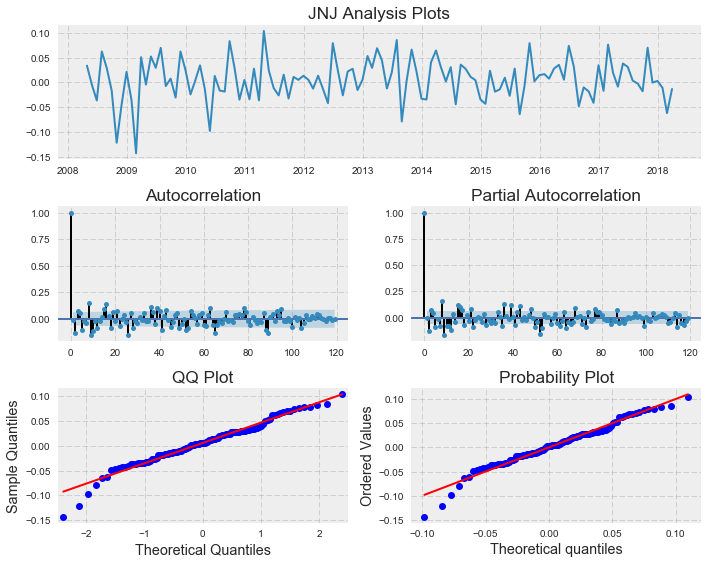

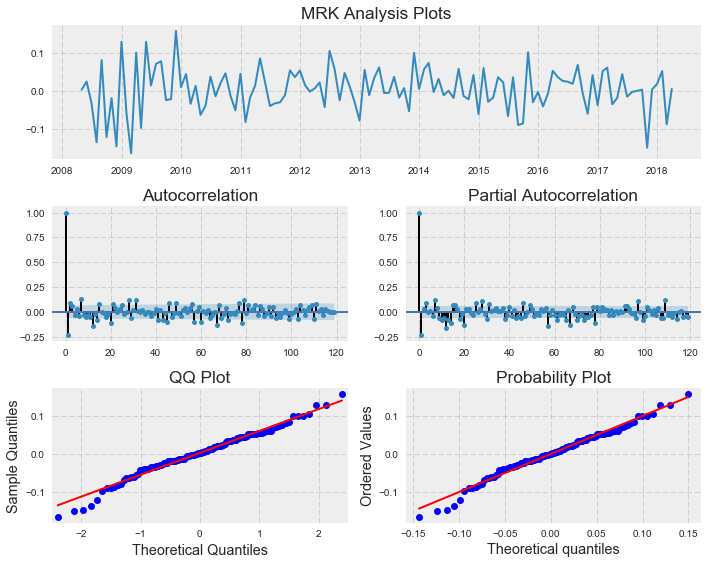

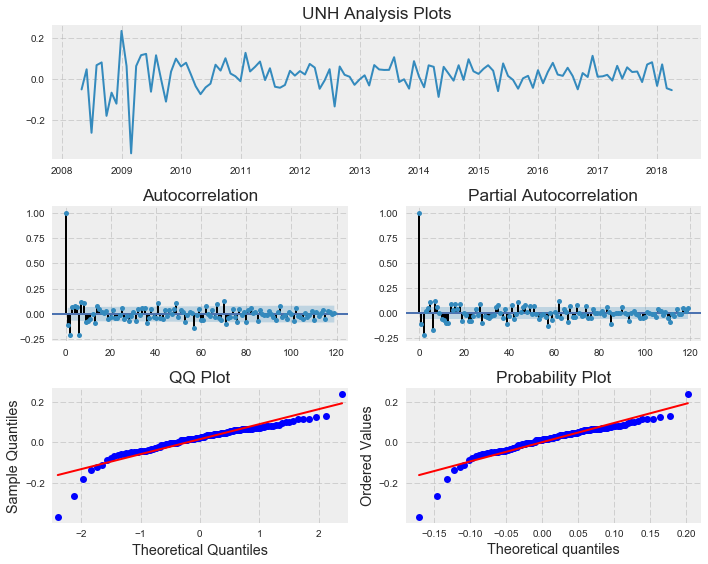

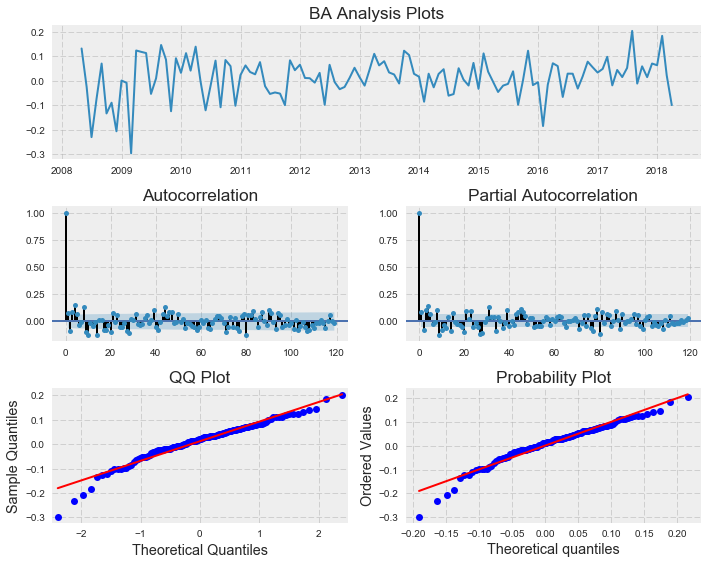

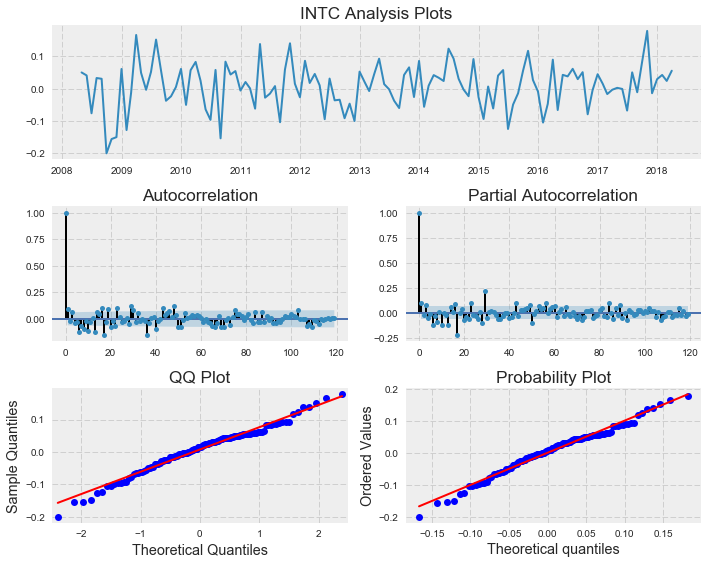

...

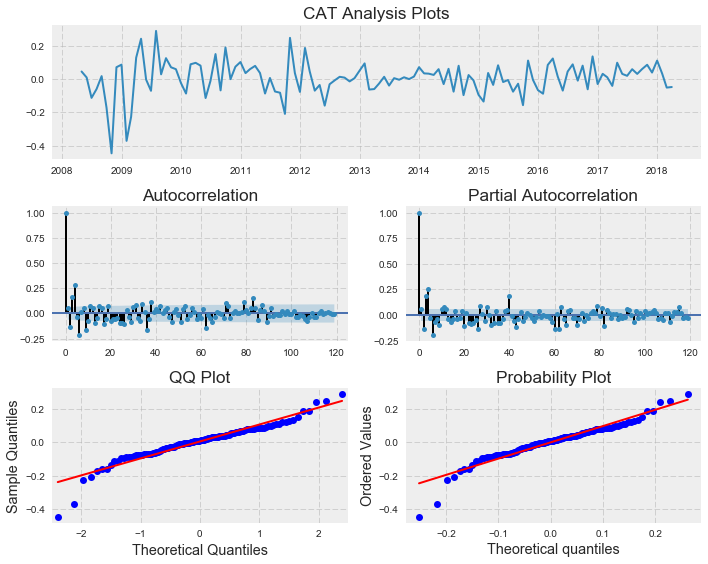

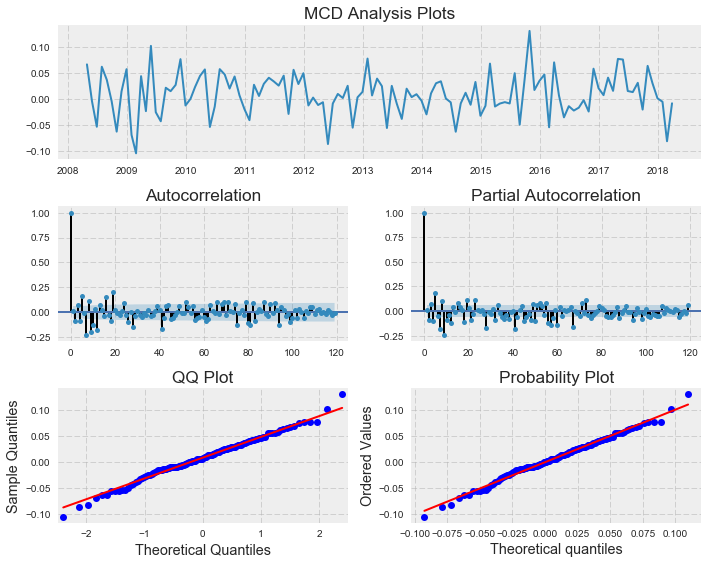

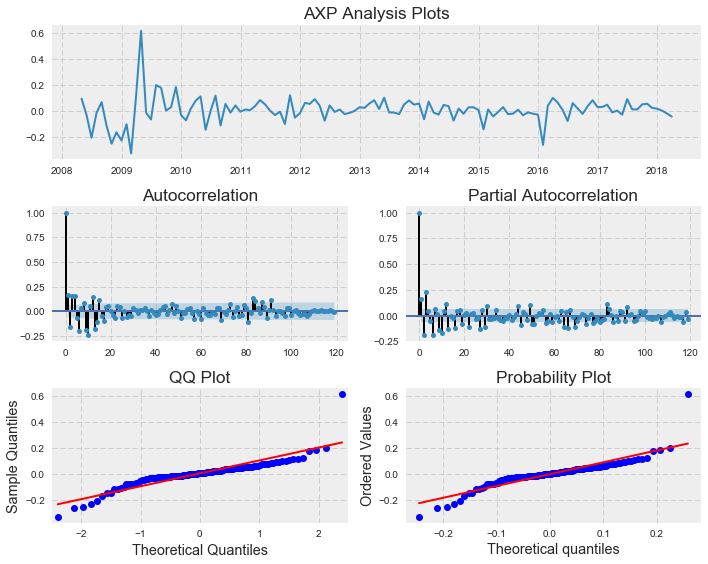

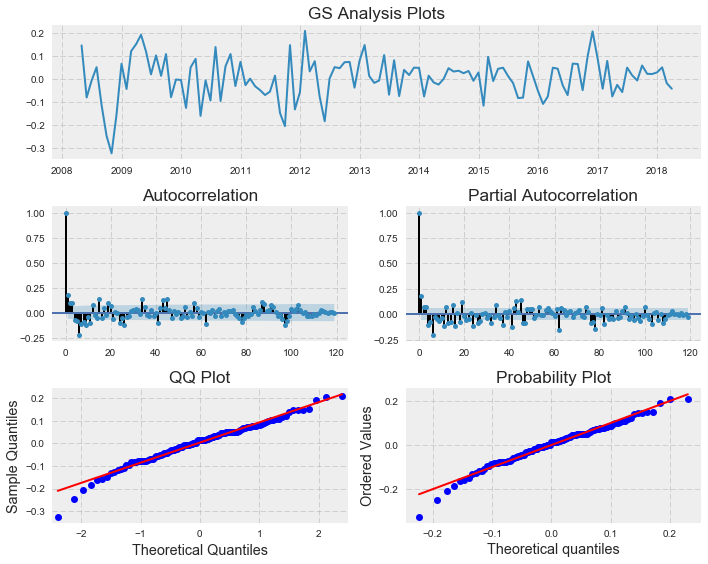

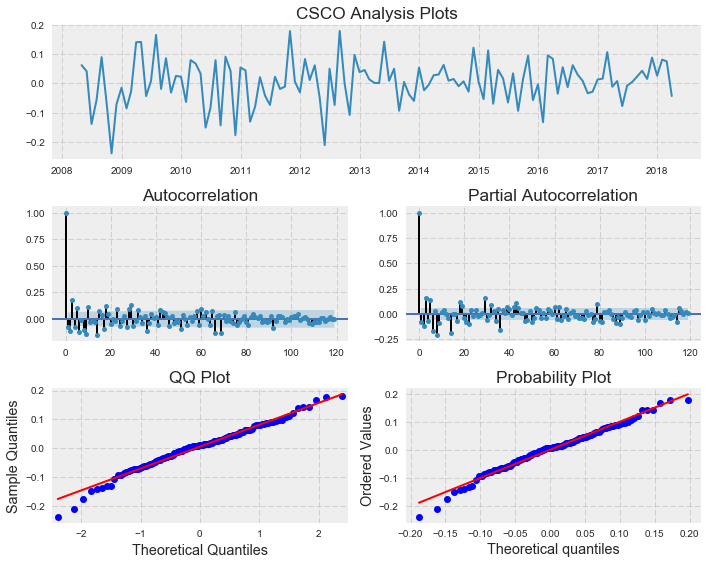

In [80]:
df_T = df.pivot(columns='Ticker', values='ret', index = 'Date').reset_index()

keys = set(series.keys()) - set(['SPY'])
npoints = 300

for i in keys:
    tsplot(y = df_T[i].tail(npoints), title = i, time_id = df_T.tail(npoints)['Date'])
    plt.show()

We first adjust an ARIMA model, but it is not significant. Just in 9 cases the intercept is significant at a $10\%$

In [95]:
df_arima = df

# Filter by taking residuals of MA(1)
resid_df = pd.DataFrame()
parameters = pd.DataFrame()

for t, df_grouped in df_arima.groupby('Ticker'):
    
    df_grouped = df_grouped.sort_values(by = 'Date').set_index('Date')
    
    model = am.ARIMA(df_grouped.drop(columns = 'Ticker'),
                     order = (1,0,0))
    result = model.fit(trend = 'c')
    # Keep residuals
    df_aux = pd.DataFrame(result.resid)
    resid_df = pd.concat([resid_df, df_aux], axis = 0)
    # Get model coeficients
    df_aux = pd.DataFrame([[t, result.params[0], result.pvalues[0]]], columns = ['Ticker','Coef','Pvalue'])
    parameters = pd.concat([parameters, df_aux])
    
parameters.sort_values(by = 'Pvalue')

C:\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:646: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if issubdtype(paramsdtype, float):
C:\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:650: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  elif issubdtype(paramsdtype, complex):
C:\Anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:577: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if issubdtype(paramsdtype, float):


,Ticker,Coef,Pvalue
0,V,0.016995,0.004935
0,HD,0.015432,0.005332
0,UNH,0.015358,0.011831
0,MCD,0.008597,0.021605
0,AAPL,0.017626,0.040558
0,TRV,0.008850,0.042912
0,NKE,0.011372,0.052452
0,MMM,0.008499,0.093016
0,MSFT,0.009744,0.097423
0,BA,0.012369,0.121319


We may test for autocorrelations in the residuas, which are the returns themselves squared. In many cases, we reject the null of no autocorrelation, so an ARCH model will be fitted. 

In [100]:
def Durbin_Watson(x):
    return(durbin_watson(x))

def Ljung_Box(x):
    return(np.min(acorr_ljungbox(x, lags = 24)[1]))

def E_test(x):
    return(het_arch(x)[1])

df['res'] = df.groupby(['Ticker']).transform(lambda x: (x - np.mean(x - x.shift(1)))**2)
WN_df = df
WN_df = WN_df.drop(columns = 'Date').groupby('Ticker').aggregate([Durbin_Watson,Ljung_Box,E_test])
WN_df = WN_df.round(decimals = 2)['res'].reset_index().sort_values(by = 'Ljung_Box')
WN_df

,Ticker,Durbin_Watson,Ljung_Box,E_test
29,^DJI,1.26,0.00,0.12
1,AXP,1.82,0.00,0.16
2,BA,1.56,0.00,0.68
3,CAT,1.47,0.00,0.00
24,UTX,1.10,0.00,0.84
23,UNH,1.73,0.00,0.00
20,PFE,0.91,0.00,0.00
7,GE,0.89,0.00,0.00
8,GS,0.86,0.00,0.13
17,MRK,1.24,0.00,0.03


In [101]:
WN_df.to_csv(path + 'ARCH_effects.csv')

Before performing the GARCH model, we have to select those firms (21) that do show aoutorrelation in their residuals. 

In [105]:
df_garch = WN_df
df_garch = df_garch[df_garch.Ljung_Box <= 0.10]
df_garch

,Ticker,Durbin_Watson,Ljung_Box,E_test
29,^DJI,1.26,0.00,0.12
1,AXP,1.82,0.00,0.16
2,BA,1.56,0.00,0.68
3,CAT,1.47,0.00,0.00
24,UTX,1.10,0.00,0.84
23,UNH,1.73,0.00,0.00
20,PFE,0.91,0.00,0.00
7,GE,0.89,0.00,0.00
8,GS,0.86,0.00,0.13
17,MRK,1.24,0.00,0.03


In [106]:
df = pd.read_csv(path + 'regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df_garch = df[df.Ticker.isin(list(df_garch['Ticker'].unique()))]
df_garch.to_csv(path + 'GARCH_model.csv')

### Back from R

The model was estimated in R, and was finally an E-GARCH model. Parameters of the model are the following. 

In [110]:
df = pd.read_csv(path + 'GARCH_results.csv').drop(columns = ['p_skew','p_shape','skew','shape'])

cd = dict({'Unnamed: 0':'Ticker',})
df = df.rename(index = str, columns = cd)
df.sort_values(by = 'vxreg1')

,Ticker,p_mu,p_archm,p_omega,p_alpha1,p_beta1,p_gamma1,p_vxreg1,mu,archm,omega,alpha1,beta1,gamma1,vxreg1
13,MRK,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.030425,0.571033,-0.793762,-0.364375,0.863145,-0.291687,-1.116024
18,UTX,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.034009,0.670685,-0.627315,-0.220447,0.892102,-0.176538,-0.727122
4,CSCO,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.076994,1.111455,-0.881632,-0.222235,0.834176,-0.205694,-0.501557
12,MMM,9.865569e-01,7.715964e-01,0.315702,0.070004,0.000015,7.102781e-02,4.650872e-01,0.000427,0.149796,-1.096790,-0.182275,0.814187,0.182763,-0.471057
15,PFE,4.514610e-01,2.237831e-01,0.000000,0.000107,0.000000,4.694777e-01,6.330168e-01,-0.007250,0.248549,-1.174039,-0.276135,0.803943,-0.043345,-0.350008
8,HD,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.029205,0.704224,-0.459468,-0.169914,0.918760,-0.175092,-0.295475
16,PG,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.037551,0.946106,-1.229299,-0.301586,0.809891,-0.302460,-0.135117
1,AXP,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,3.789395e-10,-0.006920,0.135206,0.002093,-0.168413,0.999281,-0.137046,0.063789
2,BA,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.032755,0.657684,-0.155903,-0.126963,0.971278,-0.138294,0.246946
14,NKE,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,-0.036945,0.666108,-0.380671,-0.174754,0.929057,-0.134203,0.297138


In [108]:
cols = ['mu','archm','omega','alpha1','beta1','gamma1','vxreg1']

def preparar_tabla(x):
    for c in cols:
        if x['p_'+c] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{***}$"
        elif x['p_'+c] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{**}$"
        elif x['p_'+c] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c]))
            
    return(x)

df_parameters = df.apply(preparar_tabla, axis = 1)[cols + ['Ticker']].reset_index()
df_parameters

,index,mu,archm,omega,alpha1,beta1,gamma1,vxreg1,Ticker
0,0,0.0143,-0.217,-3.52$^{**}$,-0.515$^{*}$,0.468$^{*}$,0.0784,0.863$^{**}$,X.DJI
1,1,-0.00692$^{***}$,0.135$^{***}$,0.00209$^{***}$,-0.168$^{***}$,0.999$^{***}$,-0.137$^{***}$,0.0638$^{***}$,AXP
2,2,-0.0328$^{***}$,0.658$^{***}$,-0.156$^{***}$,-0.127$^{***}$,0.971$^{***}$,-0.138$^{***}$,0.247$^{***}$,BA
3,3,0.0295$^{***}$,-0.311$^{***}$,-0.403$^{***}$,-0.214$^{**}$,0.918$^{***}$,0.421$^{***}$,0.667,CAT
4,4,-0.077$^{***}$,1.11$^{***}$,-0.882$^{***}$,-0.222$^{***}$,0.834$^{***}$,-0.206$^{***}$,-0.502$^{***}$,CSCO
5,5,0.0317$^{***}$,-0.38$^{***}$,-1.54,-0.241$^{*}$,0.727$^{***}$,0.271,1.48$^{***}$,DIS
6,6,-0.0141$^{***}$,0.147$^{***}$,-0.184$^{***}$,-0.257$^{***}$,0.965$^{***}$,-0.194$^{***}$,0.335$^{***}$,GE
7,7,-0.0614$^{***}$,0.873$^{***}$,-0.481$^{***}$,-0.233$^{***}$,0.909$^{***}$,-0.1$^{***}$,0.8$^{***}$,GS
8,8,-0.0292$^{***}$,0.704$^{***}$,-0.459$^{***}$,-0.17$^{***}$,0.919$^{***}$,-0.175$^{***}$,-0.295$^{***}$,HD
9,9,0.0539$^{***}$,-1.07$^{***}$,-0.35$^{***}$,0.0685$^{***}$,0.946$^{***}$,-0.174$^{***}$,0.333$^{***}$,JNJ


In [109]:
df_parameters.to_csv(path + 'GARCH_parameters.csv')

## VAR model

This model is not implemented in the bibliography, but it could lead to interesting results, given that we have two interactions really:

- Information demand affects volatility:
  Prior to trading their stocks, agents acquire information in order to optimize their trading strategy. Periods where the information demand grows should preceed periods with high volume of trade and thus high level of volatility. 
  
- Volatility affects information demand: 
  When volatility in the market rises, a risk averse agent would tend to 
  acquire the maximum quantity of information that is available. Then, periods with high volatility should preceed periods where the level of information demand is higher. 
  
In this set-up, it makes sense to model the two variables with a $VAR$ model. 
 

In [27]:
df = pd.read_csv(path + 'regresion_week.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df.head()

,Date,Ticker,RV,market_RV,SVI,market_info,ret,ret_1,SPY,SPY_1,RV_1,market_RV_1
0,2008-03-30,AAPL,0.511099,2.507347,-0.012382,-0.012287,0.070537,0.051266,-0.004325,0.018878,-1.574216,1.070064
1,2008-03-30,AXP,2.344452,2.507347,0.001957,-0.012287,-0.063524,0.114391,-0.004325,0.018878,2.752366,1.070064
2,2008-03-30,BA,2.043569,2.507347,-0.004381,-0.012287,-0.017941,-0.018937,-0.004325,0.018878,0.445043,1.070064
3,2008-03-30,CAT,1.737717,2.507347,0.022219,-0.012287,0.043344,-0.013055,-0.004325,0.018878,-5.599538,1.070064
4,2008-03-30,CSCO,0.763235,2.507347,0.019341,-0.012287,-0.028252,0.018334,-0.004325,0.018878,-2.457050,1.070064


In [28]:
# Select variables for the VAR
var_data = df[['Date', 'RV', 'SVI','Ticker','SPY','market_info','ret']]
var_data = var_data.set_index('Date')

pvalues_RV = pd.DataFrame()
parameters_RV = pd.DataFrame()
pvalues_SVI = pd.DataFrame()
parameters_SVI = pd.DataFrame()

results_dict = dict()

for t, data in var_data.groupby('Ticker'):
    
    endog = ['RV','market_info']
    var = endog 
    data_endog = data[endog].dropna()
    
    model = VAR(data_endog)
    # Fit model
    results = model.fit(maxlags=5, ic='bic',trend='c')
    results_dict[t] = results
    # Get model coeficients
    

C:\Anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:461: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  params = np.linalg.lstsq(z, y_sample)[0]


### Granger Causality test

One is often interested in whether a variable or group of variables is “causal” for another variable, for some definition of “causal”. In the context of VAR models, one can say that a set of variables are Granger-causal within one of the VAR equations. 

https://en.wikipedia.org/wiki/Granger_causality


In [29]:
for k in results_dict.keys():
    print(k,'\n')
    print(results_dict[k].test_causality('RV',['market_info'],signif=0.1))

MCD 

Granger causality f-test
   Test statistic   Critical Value          p-value         df
--------------------------------------------------------------
         2.146652         1.852972            0.058  (5, 1012)
H_0: ['market_info'] do not Granger-cause RV
Conclusion: reject H_0 at 10.00% significance level
{'statistic': 2.1466521979481703, 'signif': 0.1, 'conclusion': 'reject', 'pvalue': 0.05782844894366434, 'crit_value': 1.8529715864769718, 'df': (5, 1012)}
UTX 

Granger causality f-test
   Test statistic   Critical Value          p-value         df
--------------------------------------------------------------
         4.512361         1.852972            0.000  (5, 1012)
H_0: ['market_info'] do not Granger-cause RV
Conclusion: reject H_0 at 10.00% significance level
{'statistic': 4.5123610396567715, 'signif': 0.1, 'conclusion': 'reject', 'pvalue': 0.0004497520306156361, 'crit_value': 1.8529715864769718, 'df': (5, 1012)}
DIS 

Granger causality f-test
   Test statistic   Cri

Granger causality f-test
   Test statistic   Critical Value          p-value         df
--------------------------------------------------------------
         5.718366         1.852972            0.000  (5, 1012)
H_0: ['market_info'] do not Granger-cause RV
Conclusion: reject H_0 at 10.00% significance level
{'statistic': 5.718365958142082, 'signif': 0.1, 'conclusion': 'reject', 'pvalue': 3.2713581037449494e-05, 'crit_value': 1.8529715864769718, 'df': (5, 1012)}
KO 

Granger causality f-test
   Test statistic   Critical Value          p-value         df
--------------------------------------------------------------
         4.505823         1.852972            0.000  (5, 1012)
H_0: ['market_info'] do not Granger-cause RV
Conclusion: reject H_0 at 10.00% significance level
{'statistic': 4.505823047841741, 'signif': 0.1, 'conclusion': 'reject', 'pvalue': 0.00045611312749126767, 'crit_value': 1.8529715864769718, 'df': (5, 1012)}
INTC 

Granger causality f-test
   Test statistic   Critica

Analyse the VAR model for one time series. We pick the one for the Dow Jones index. 

In [21]:
for k in results_dict.keys():
    print('################################''\n')
    print(k,'\n')
    print('################################''\n')

    a = list(results_dict[k].test_normality())
    print('\n')

################################

MCD 

################################

Normality skew/kurtosis Chi^2-test
   Test statistic   Critical Value          p-value  df
-------------------------------------------------------
         3.251453         9.487729            0.517   4
H_0: data generated by normally-distributed process
Conclusion: fail to reject H_0 at 5.00% significance level


################################

UTX 

################################

Normality skew/kurtosis Chi^2-test
   Test statistic   Critical Value          p-value  df
-------------------------------------------------------
         8.229858         9.487729            0.084   4
H_0: data generated by normally-distributed process
Conclusion: fail to reject H_0 at 5.00% significance level


################################

DIS 

################################

Normality skew/kurtosis Chi^2-test
   Test statistic   Critical Value          p-value  df
-------------------------------------------------------

### Impulse Response Analysis
Impulse responses are of interest in econometric studies: they are the estimated responses to a unit impulse in one of the variables. They are computed in practice using the MA($\infty$) representation of the VAR(p) process:
\begin{equation}
Y_t = \mu + \sum_{i=0}^\infty \Phi_i u_{t-i}
\end{equation}


MCD 



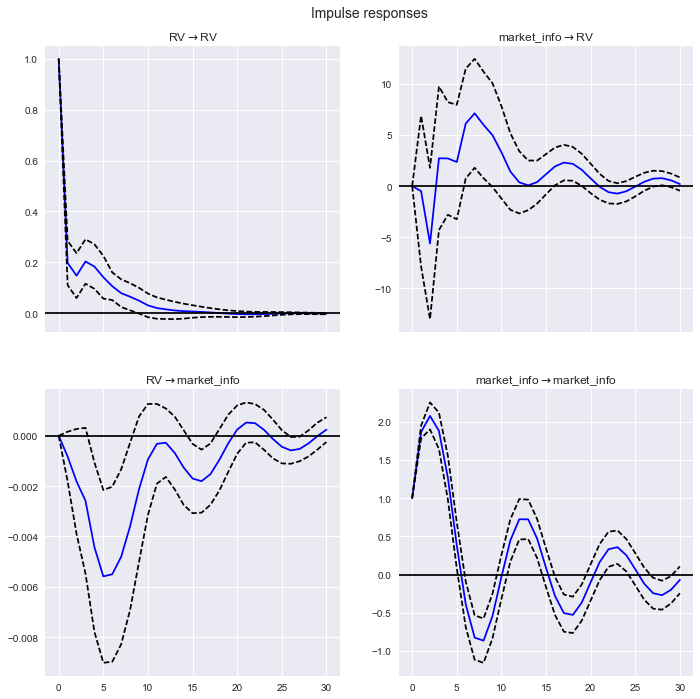

UTX 



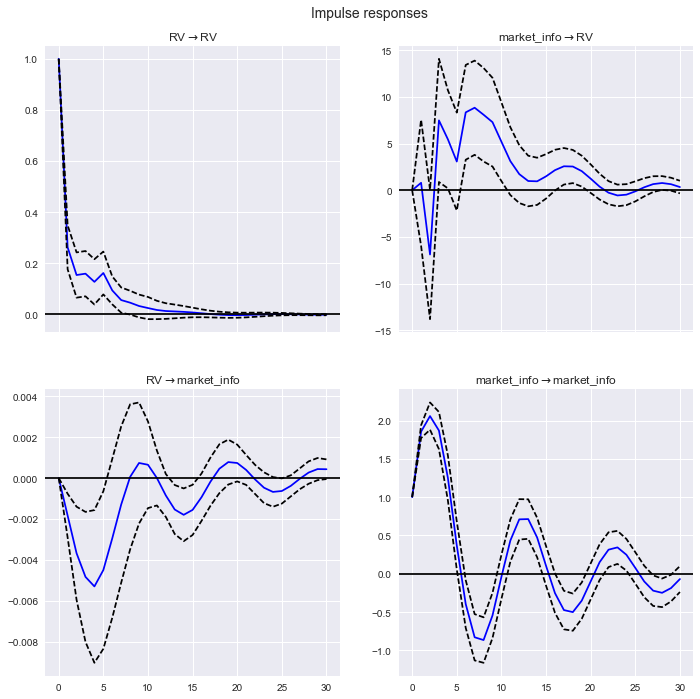

DIS 



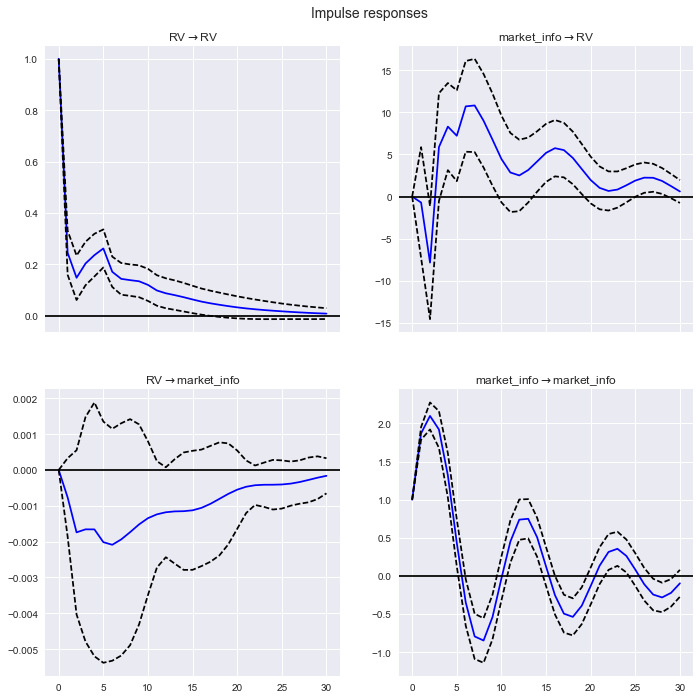

JPM 



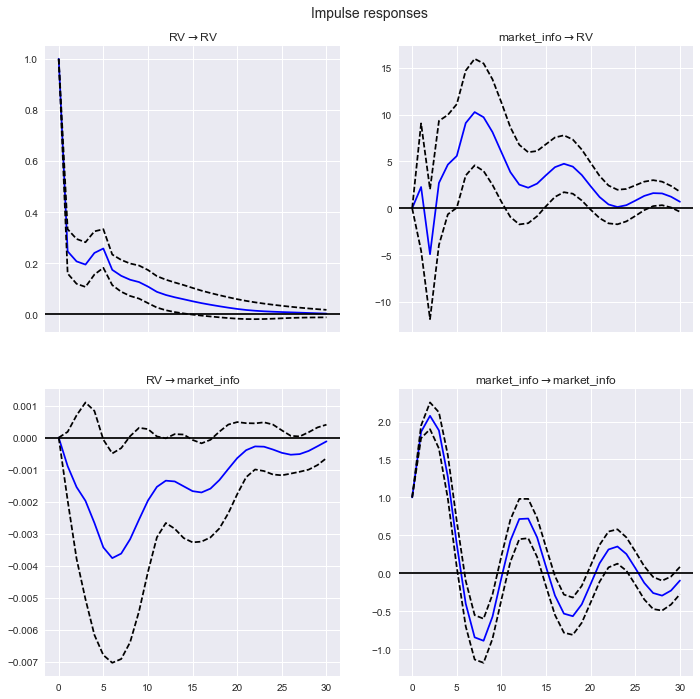

HD 



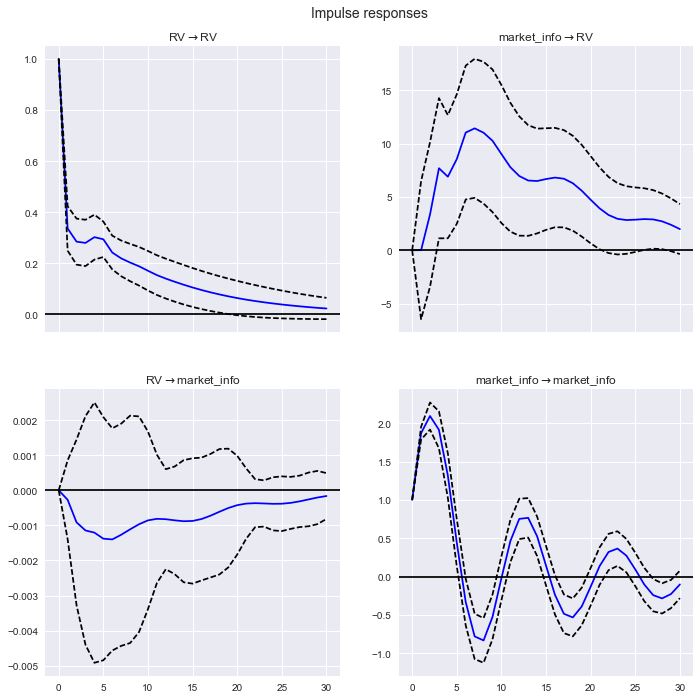

GE 



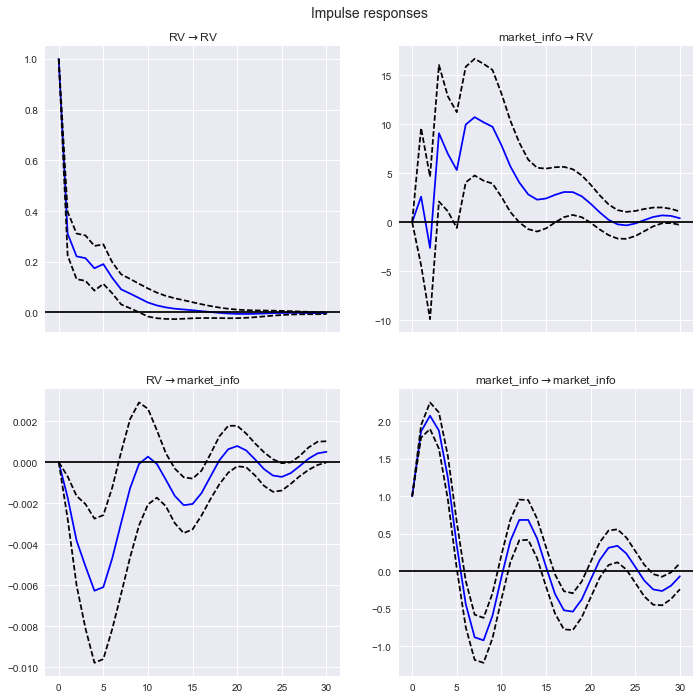

VZ 



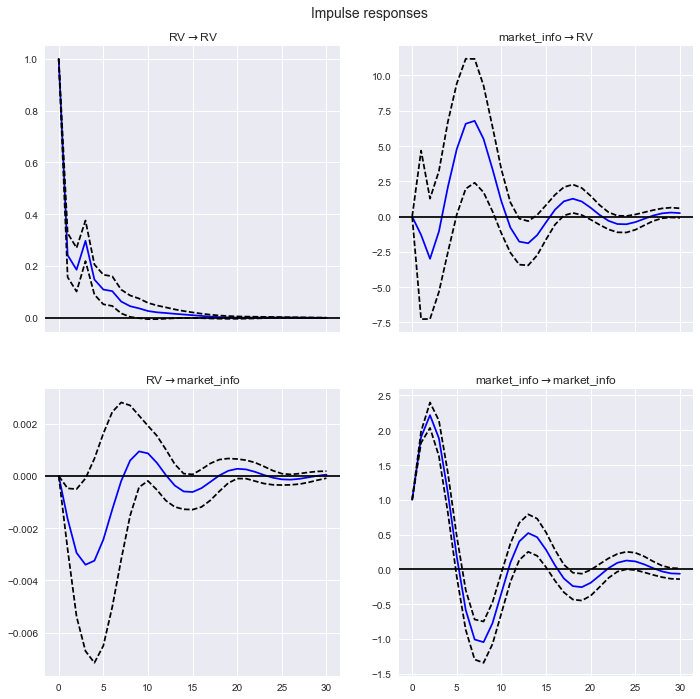

MSFT 



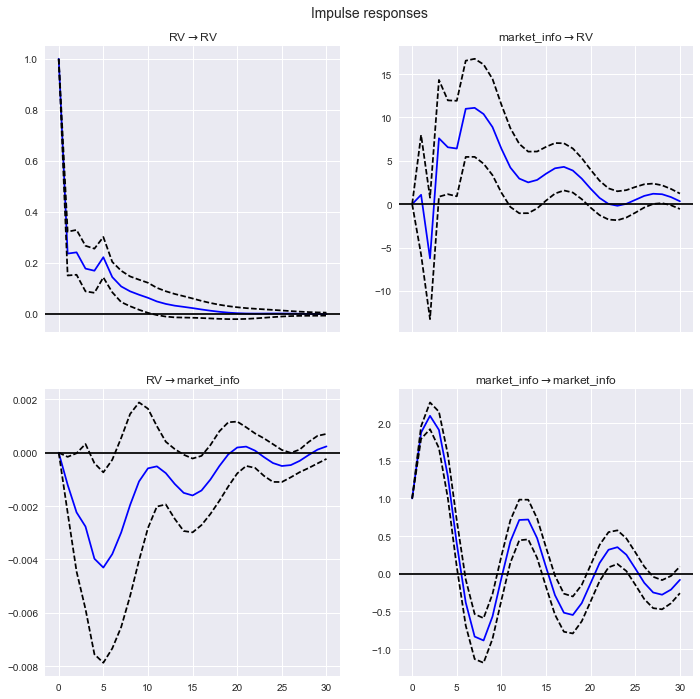

^DJI 



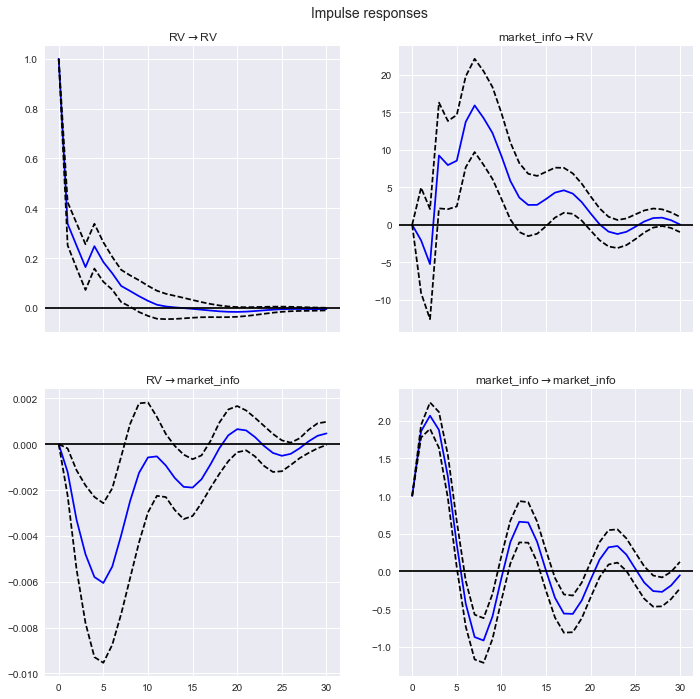

IBM 



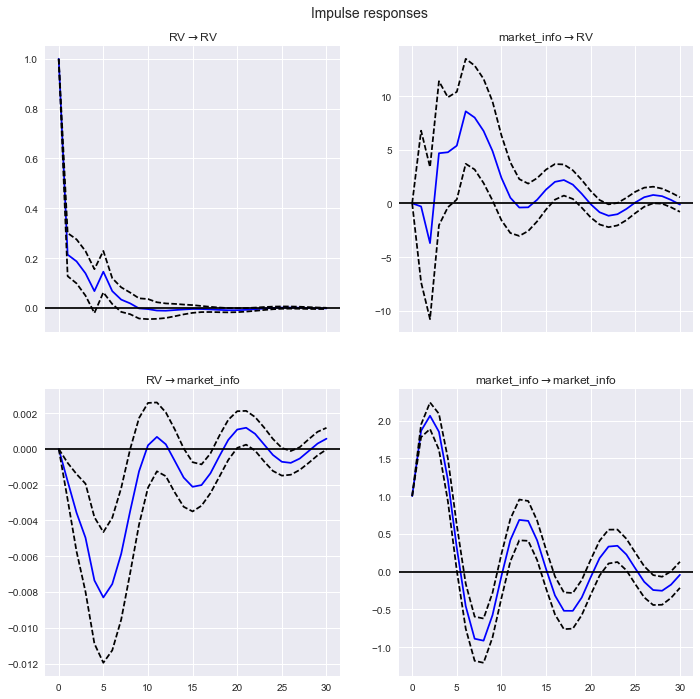

BA 



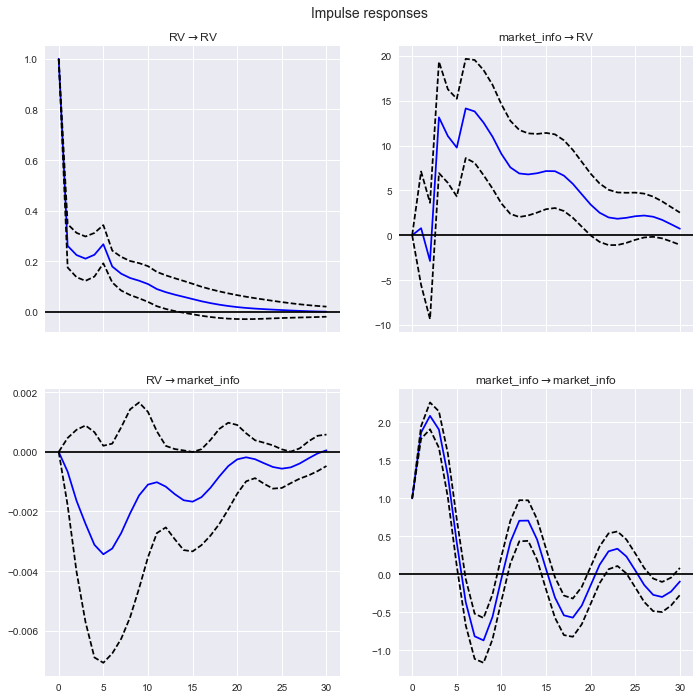

CAT 



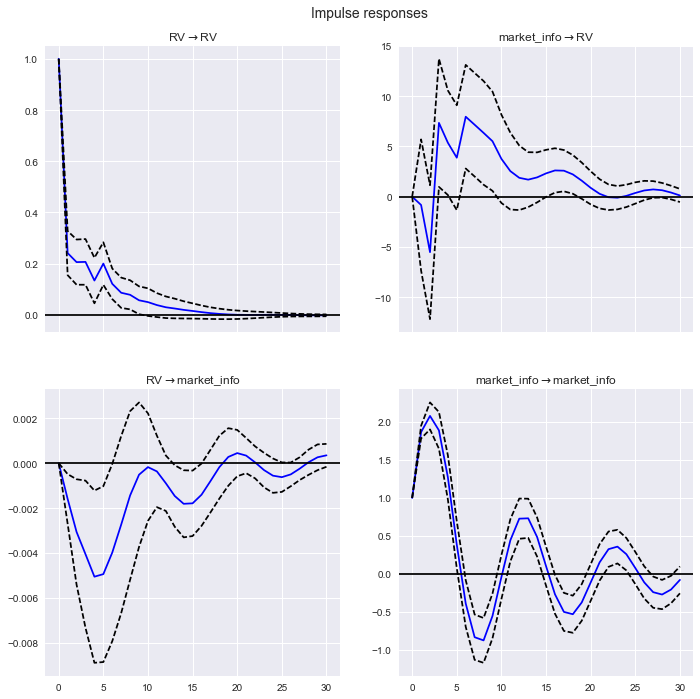

AXP 



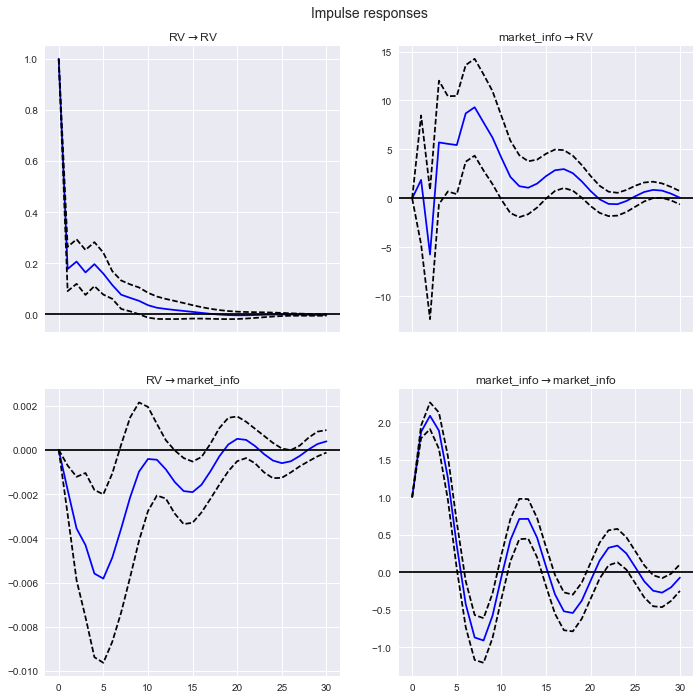

V 



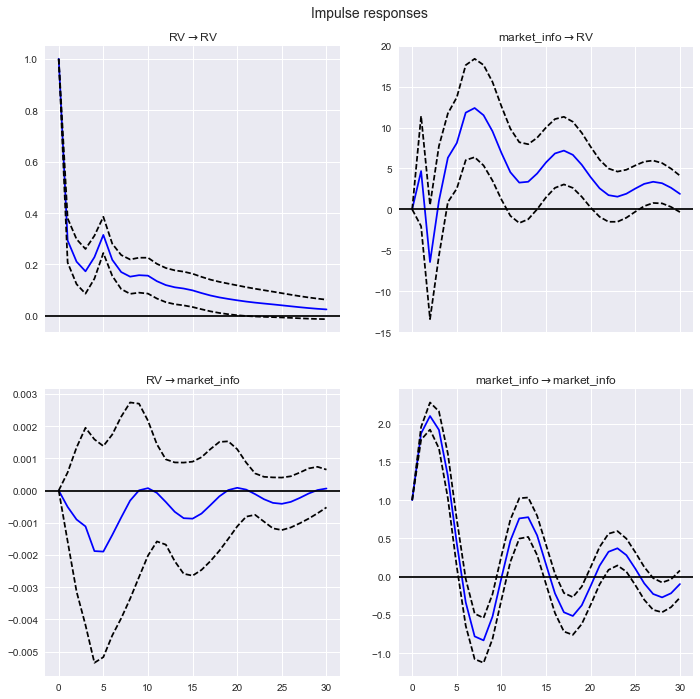

CVX 



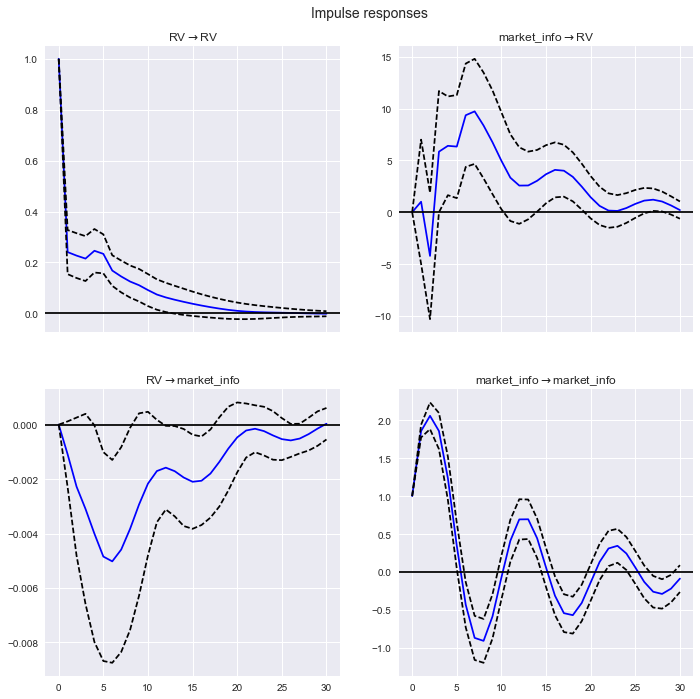

JNJ 



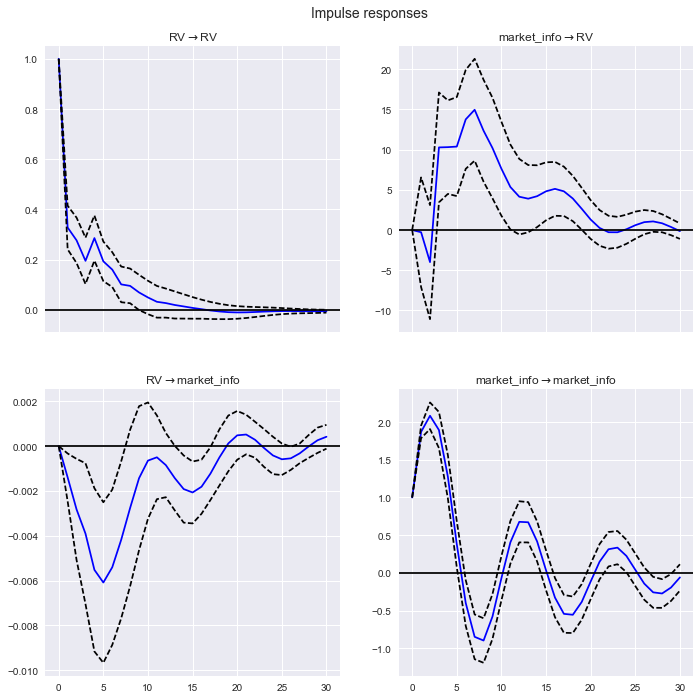

XOM 



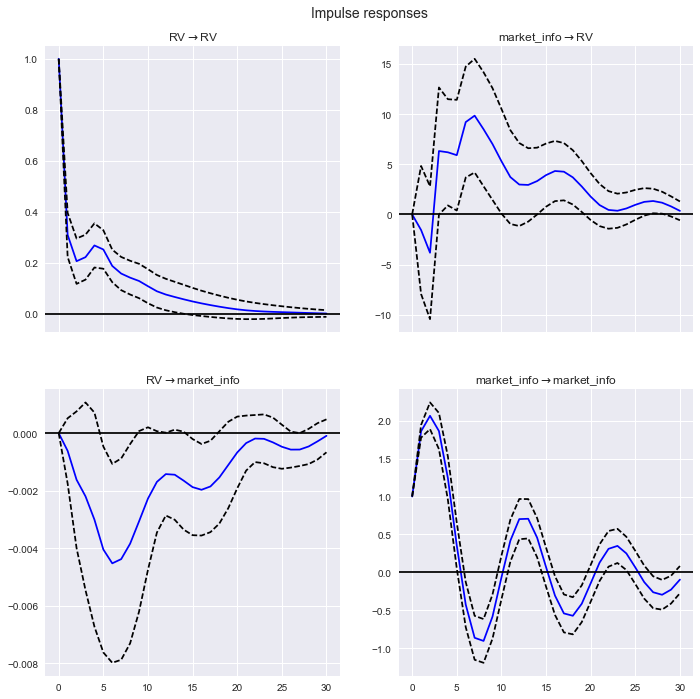

GS 



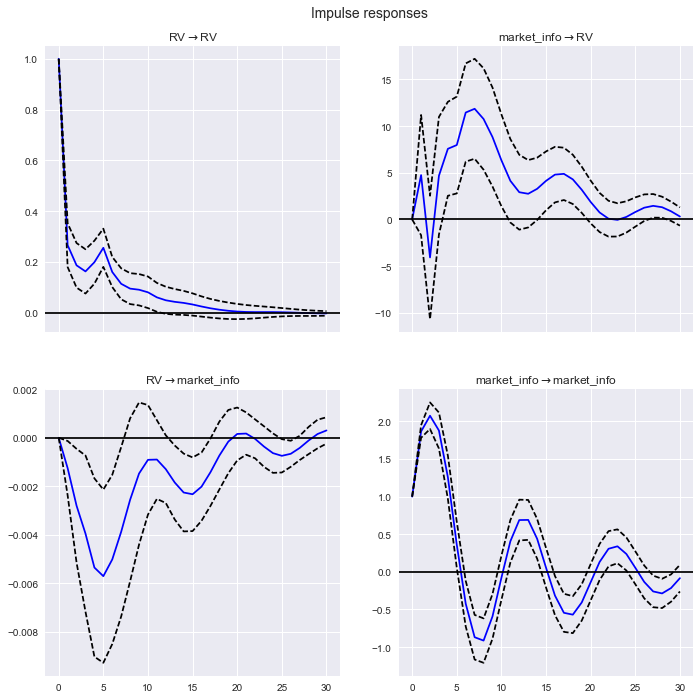

KO 



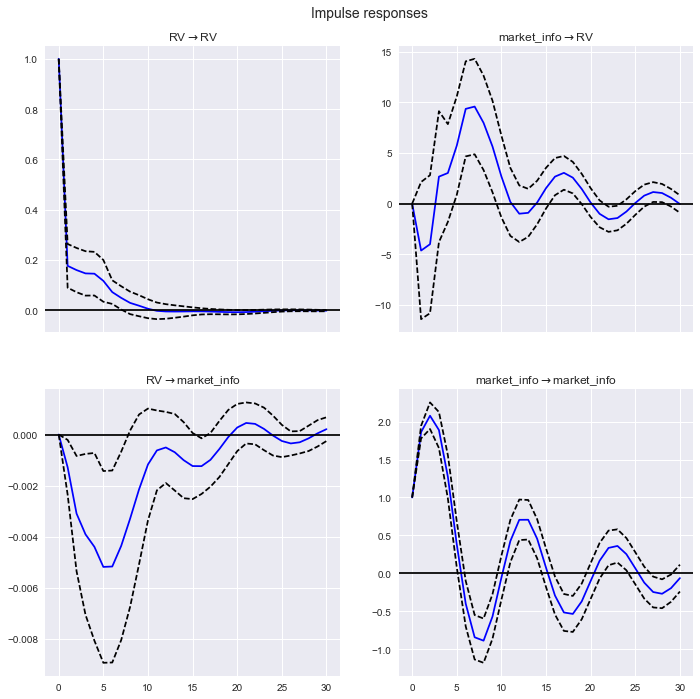

INTC 



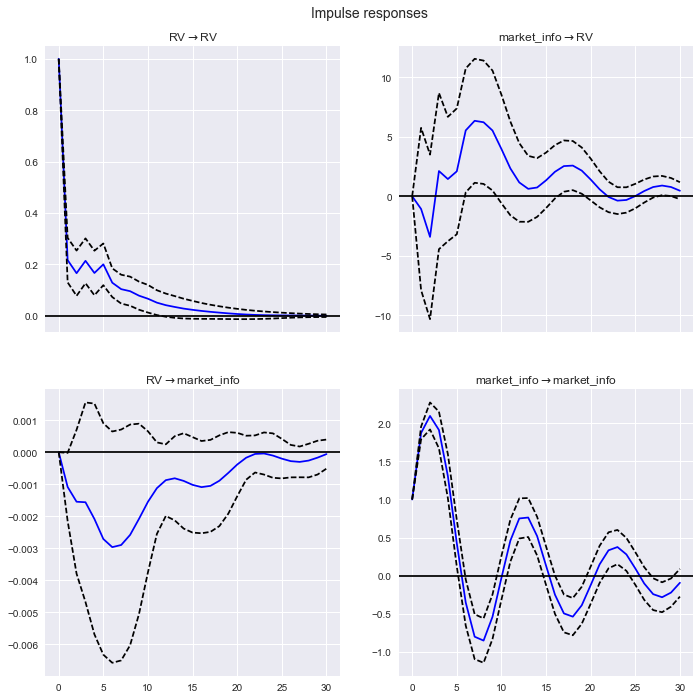

PFE 



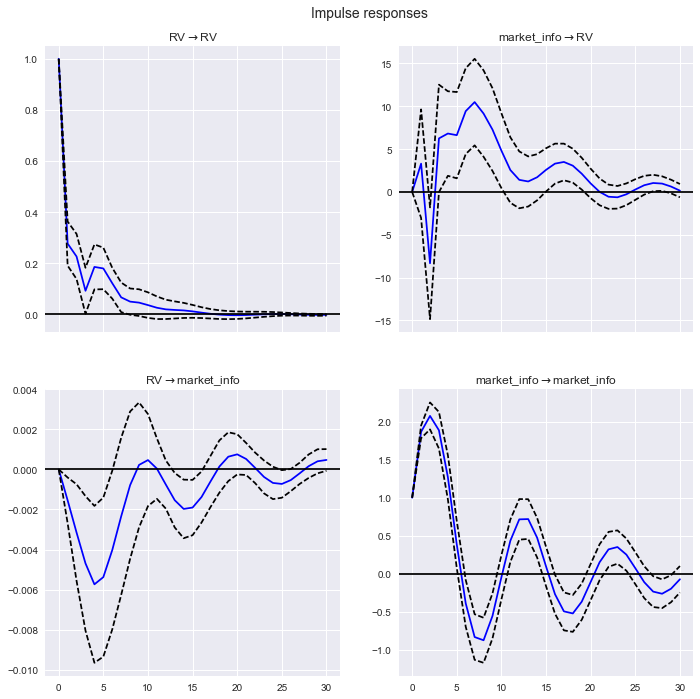

TRV 



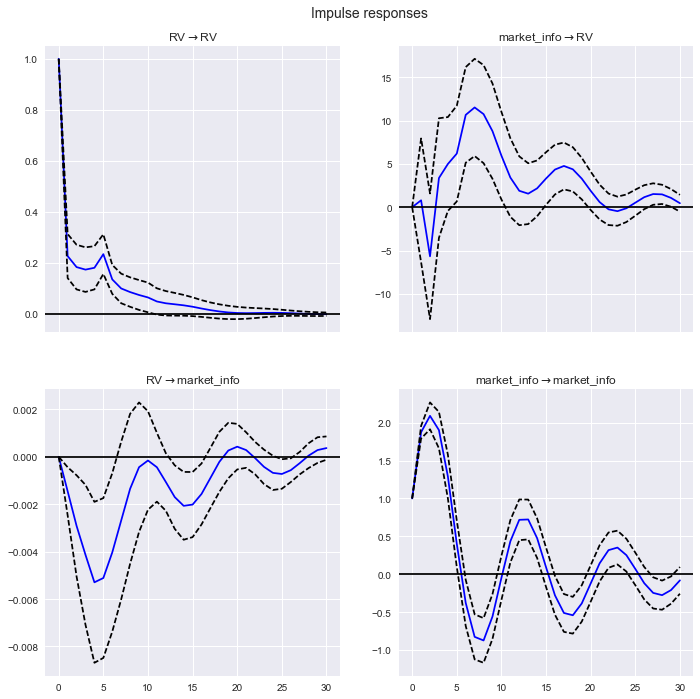

CSCO 



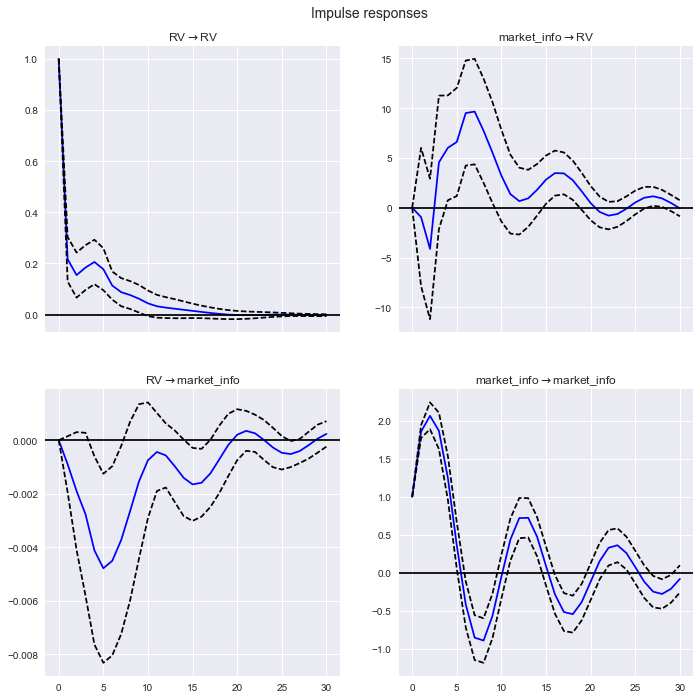

UNH 



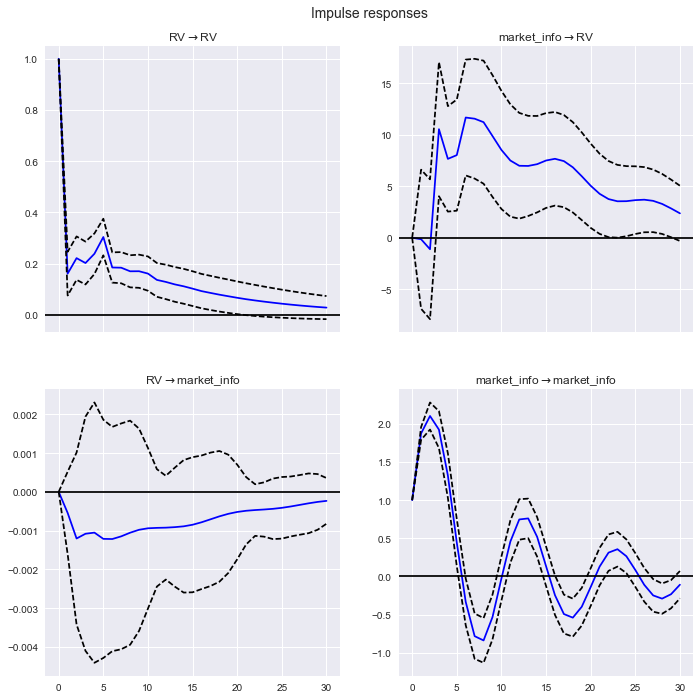

PG 



KeyboardInterrupt: 

In [30]:
for k in results_dict.keys():
    
    # Plot IRAnalysis
    print(k,'\n')
    # Calculate impulse response analysis
    irf = results_dict[k].irf(30)
    # Plot
    irf.plot(orth=False)
    plt.show()

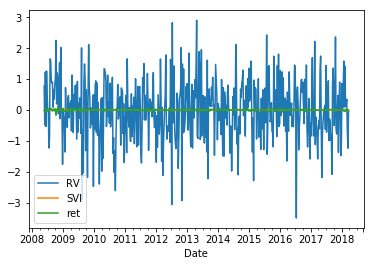

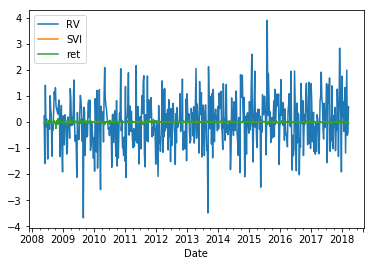

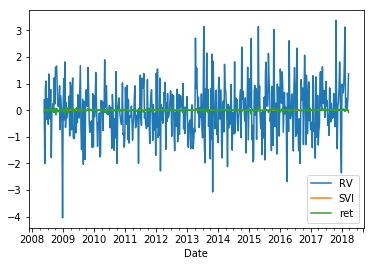

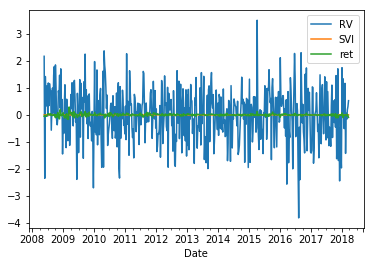

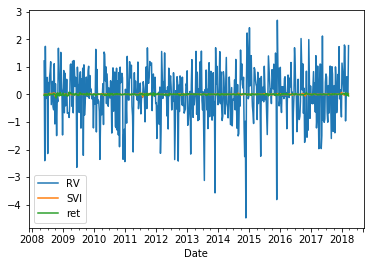

...

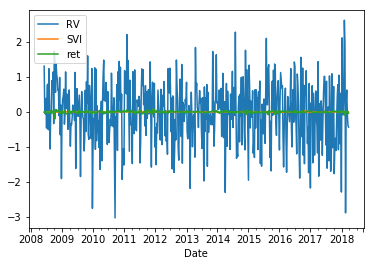

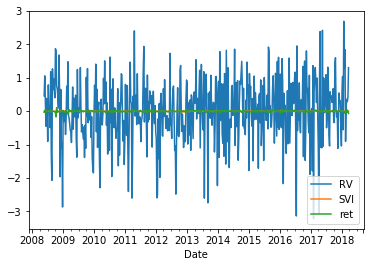

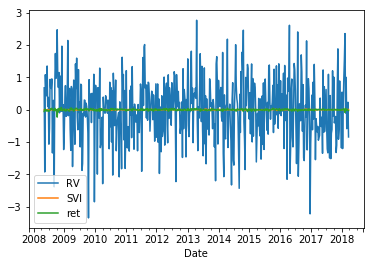

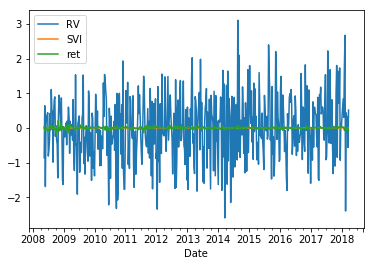

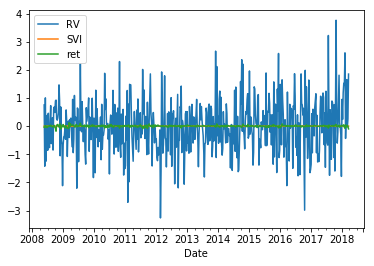

In [263]:
for k in results_dict.keys():
    
    results_dict[k].resid.plot()
    plt.show()

### Cumulative effects

The cumulative effects $\Psi_n = \sum_{i=0}^n \Phi_i$ can be plotted with the long run effects as follows:

In [31]:
cumulative = pd.DataFrame()
try:
    endog.remove('RV')
except:
    pass

for k in results_dict.keys():
    aux = pd.DataFrame([[k] + list(results_dict[k].long_run_effects()[0,1:])], columns = ['Ticker'] + endog)
    cumulative = pd.concat([cumulative, aux])
    
print(cumulative.sort_values(by = 'market_info').mean())
cumulative.sort_values(by = 'market_info')

market_info    100.472135
dtype: float64


,Ticker,market_info
0,VZ,22.184824
0,MCD,40.806343
0,KO,44.767355
0,IBM,47.155755
0,INTC,48.546882
0,CAT,63.908048
0,UTX,67.424290
0,CSCO,68.106239
0,AXP,68.635947
0,PG,73.101185


MCD 



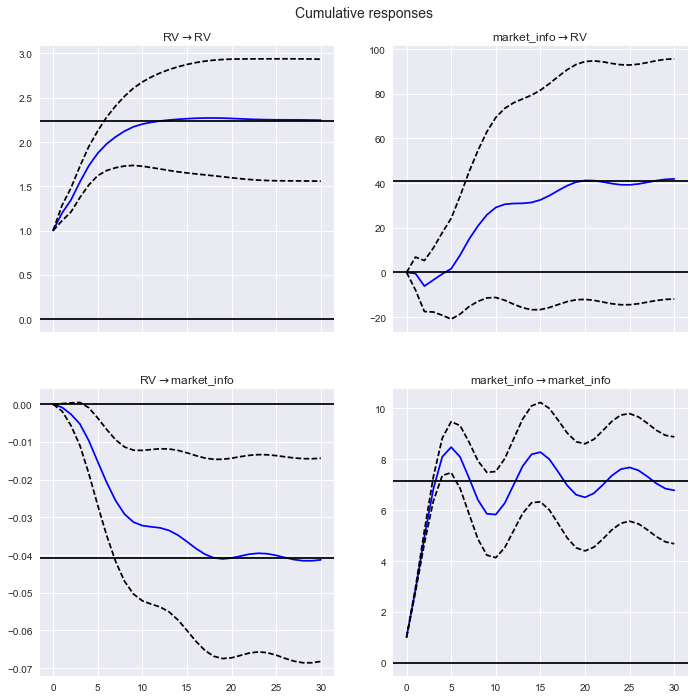

UTX 



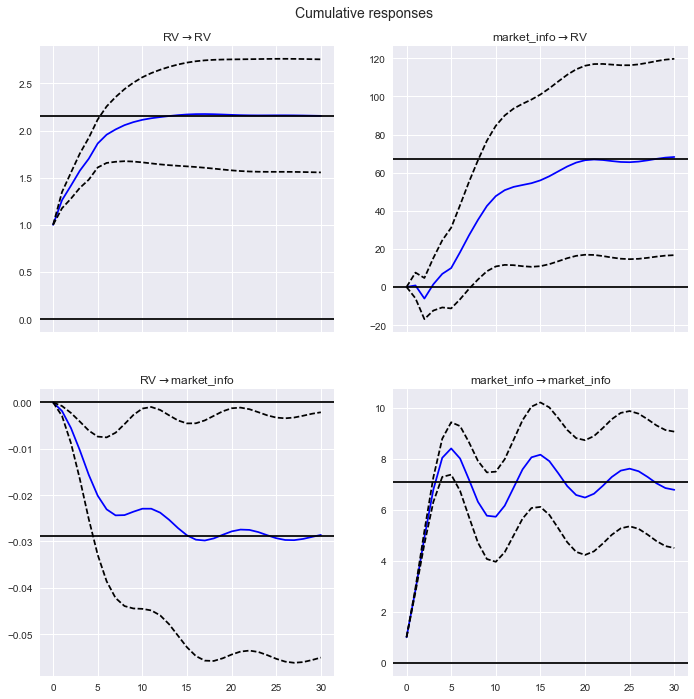

DIS 



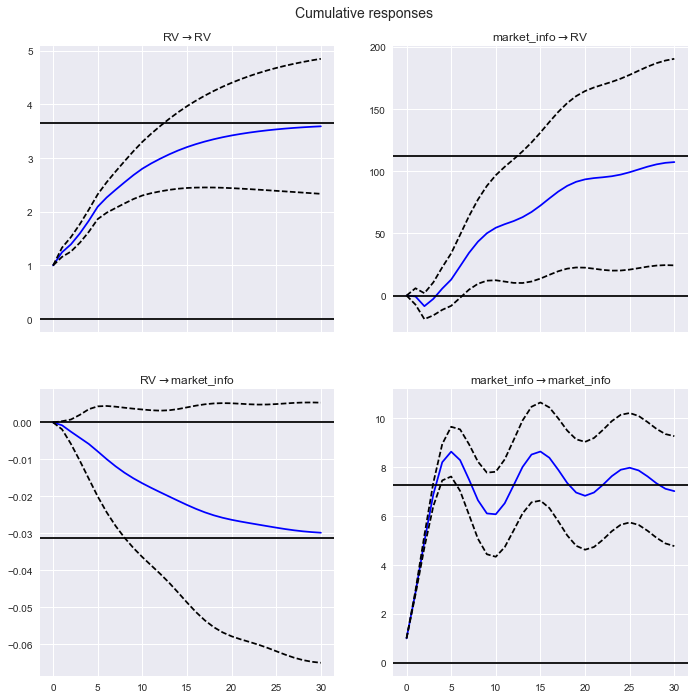

JPM 



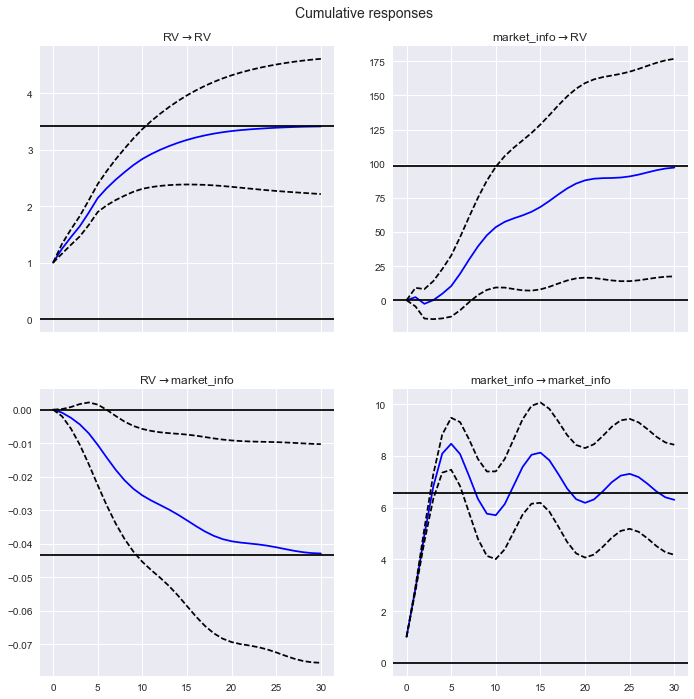

HD 



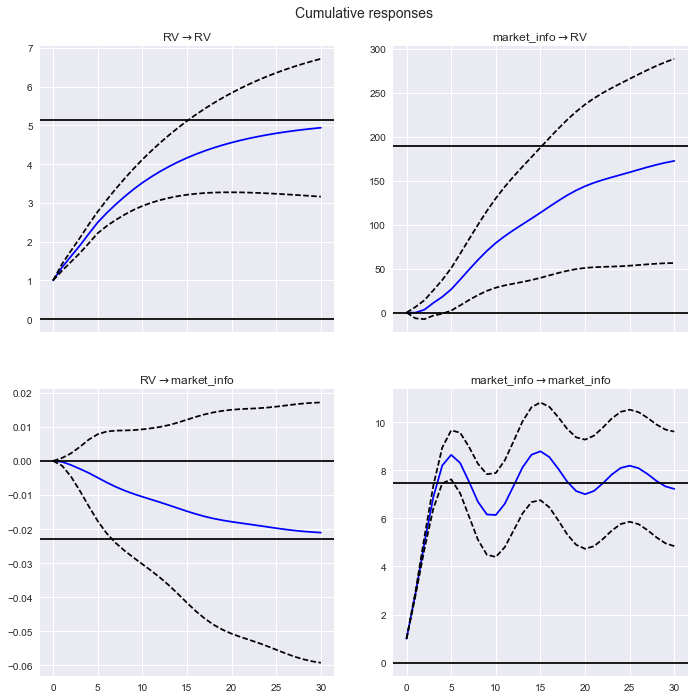

GE 



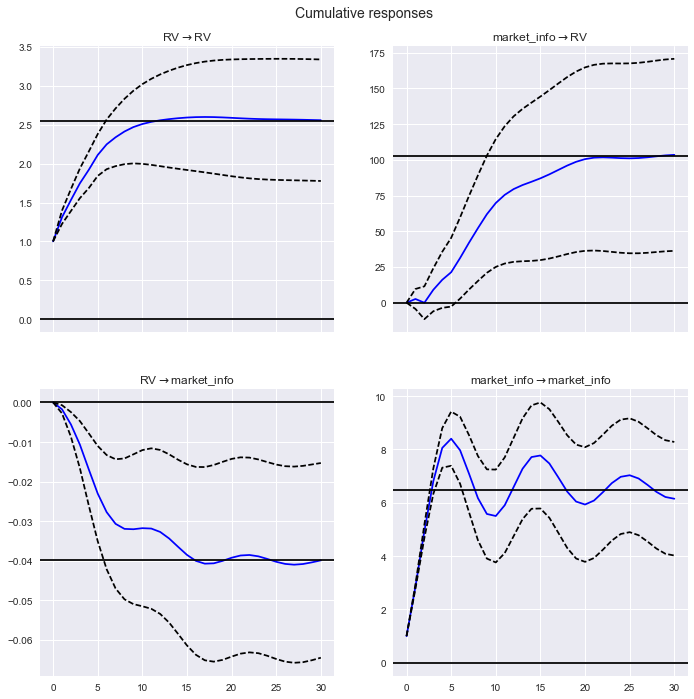

VZ 



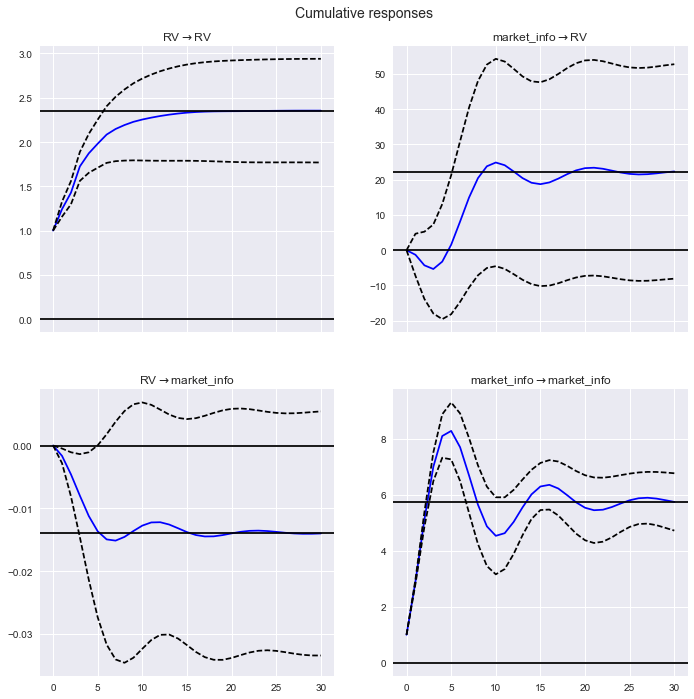

MSFT 



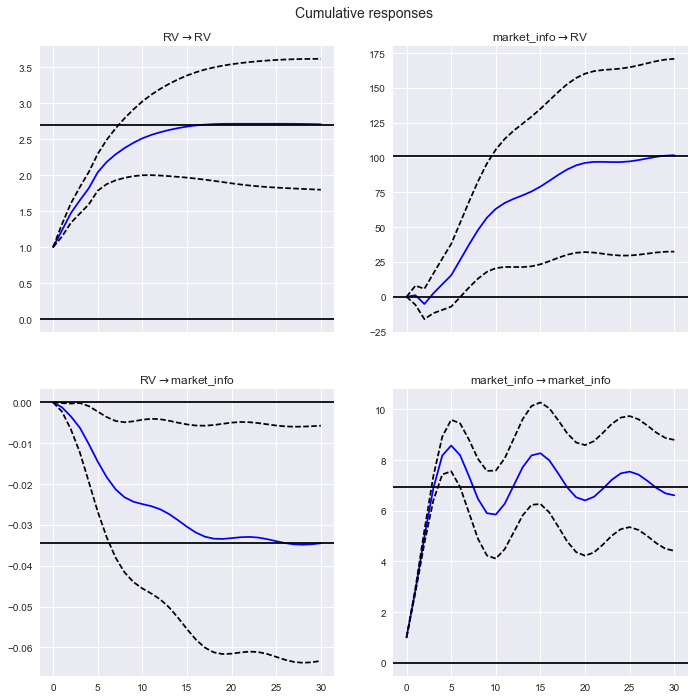

^DJI 



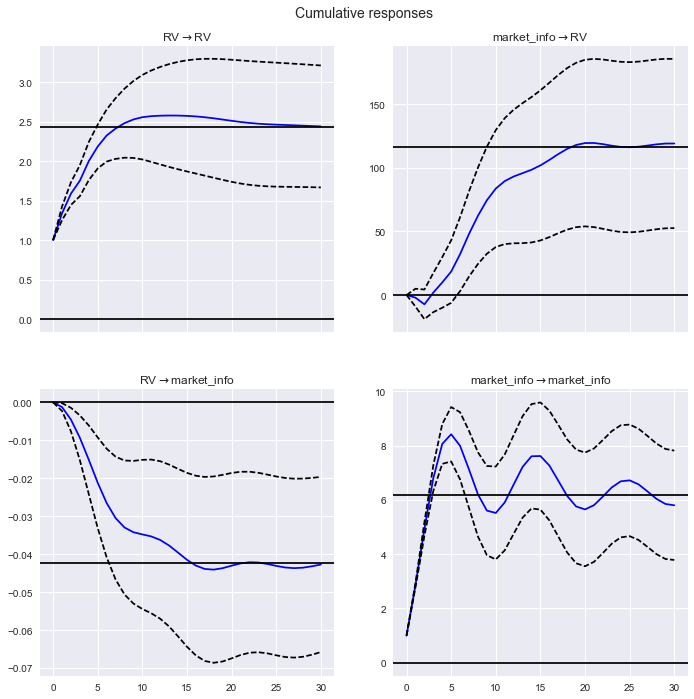

IBM 



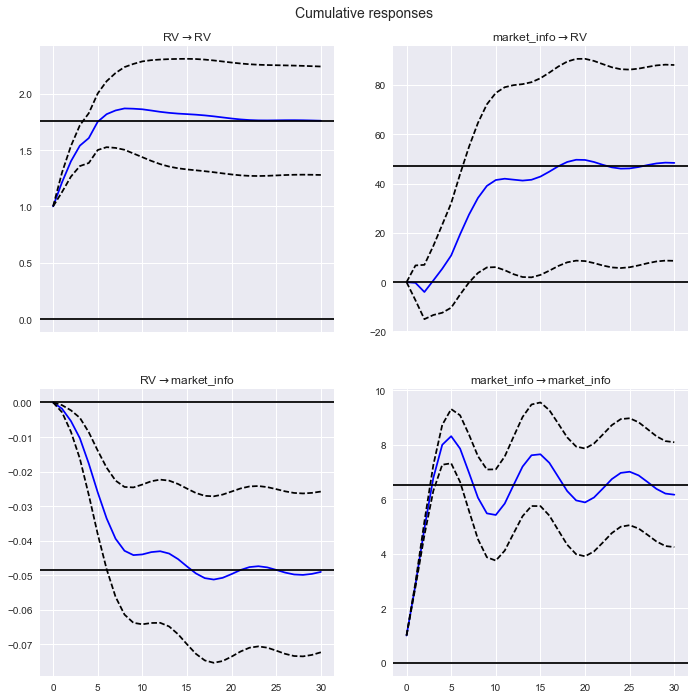

BA 



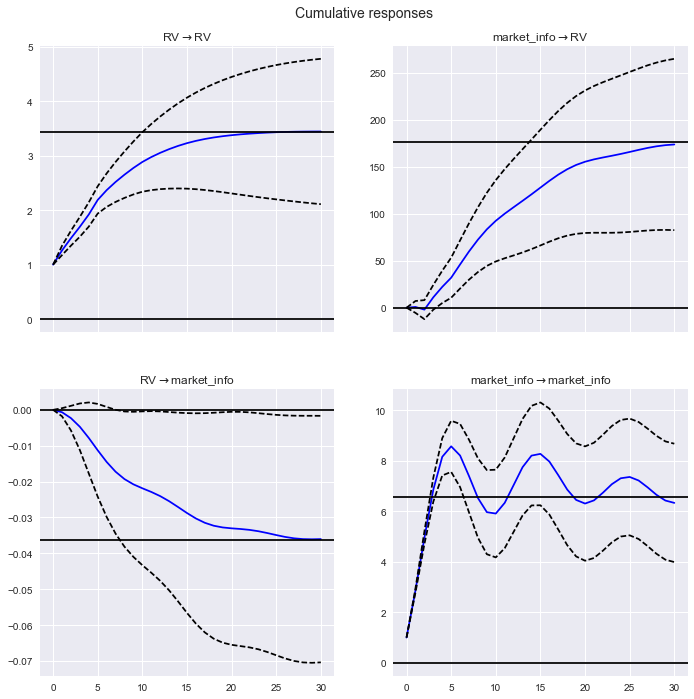

CAT 



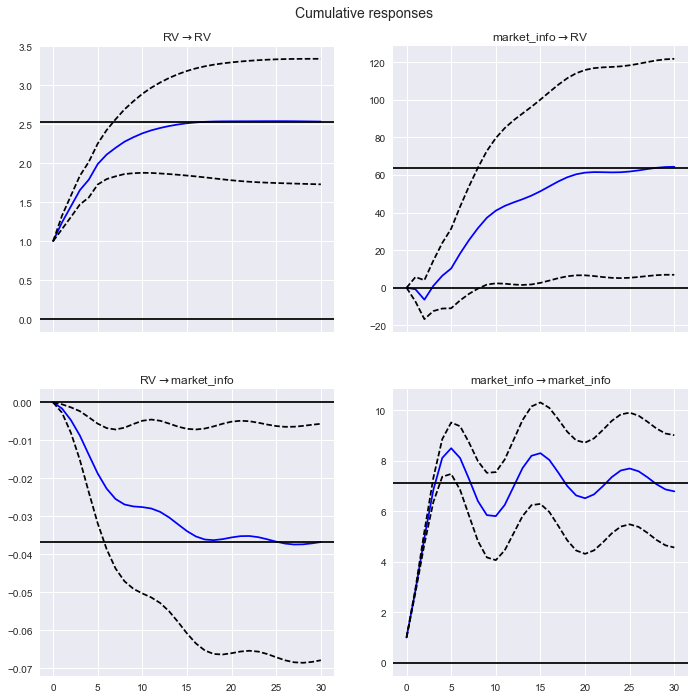

AXP 



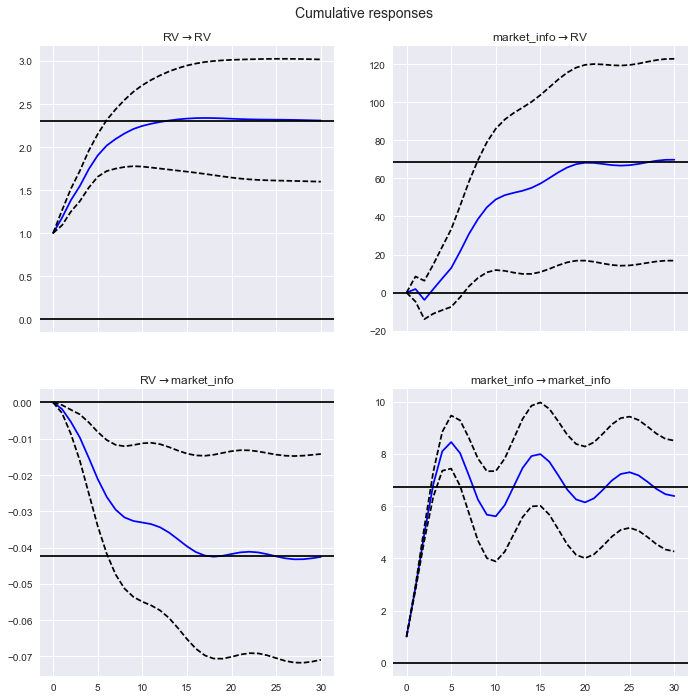

V 



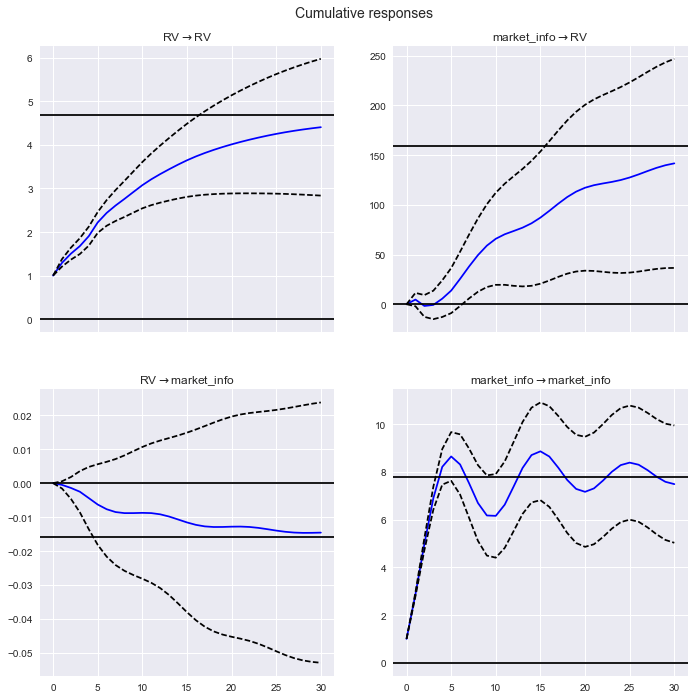

CVX 



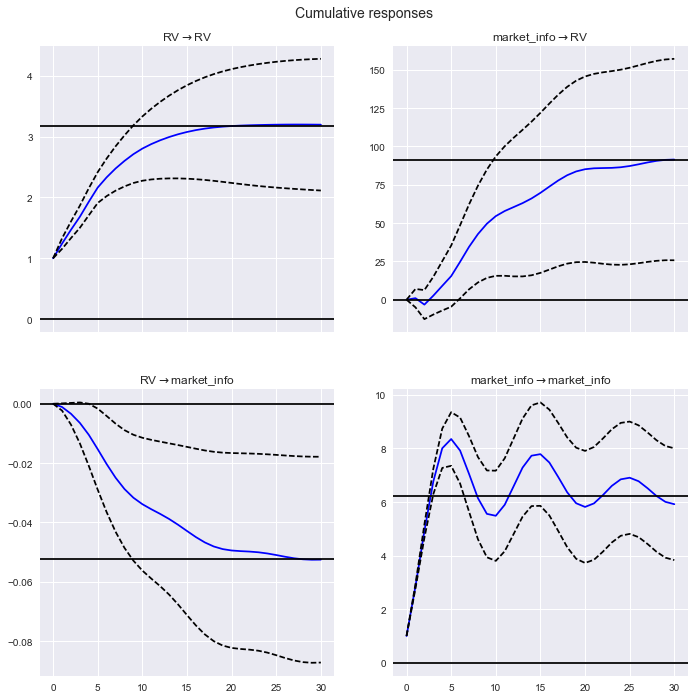

JNJ 



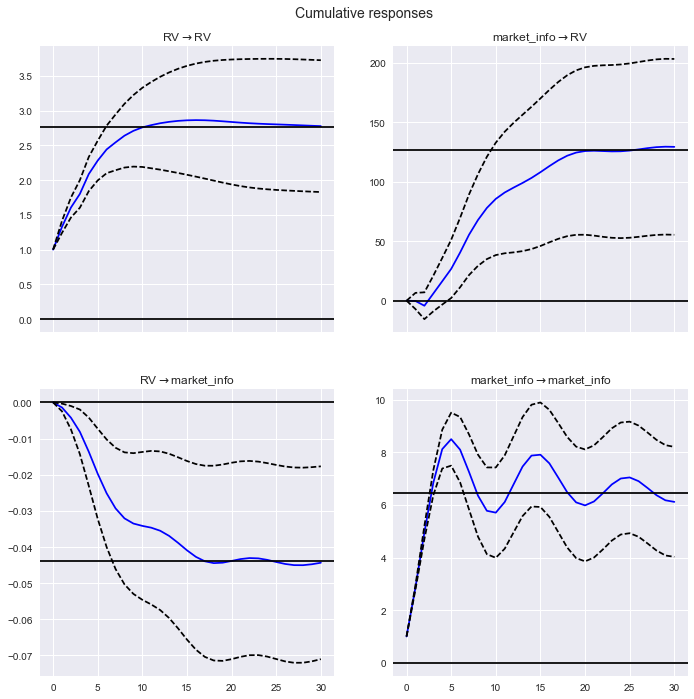

XOM 



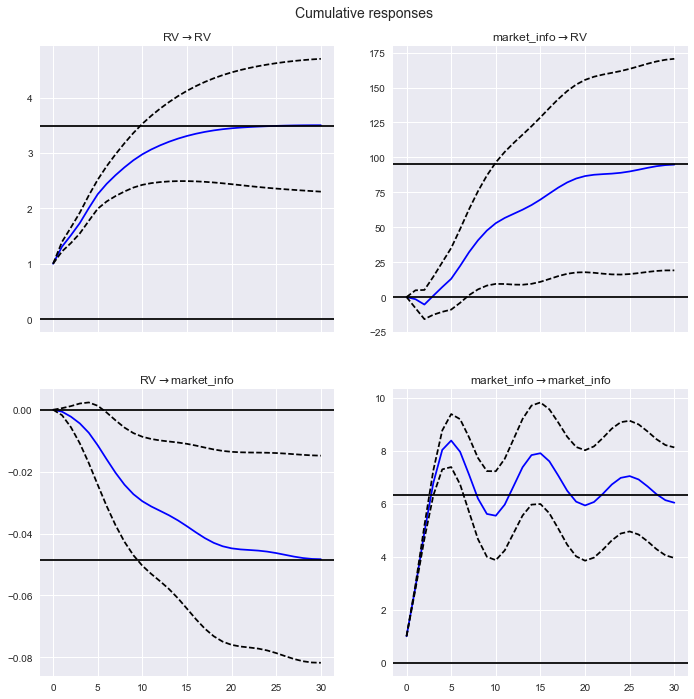

GS 



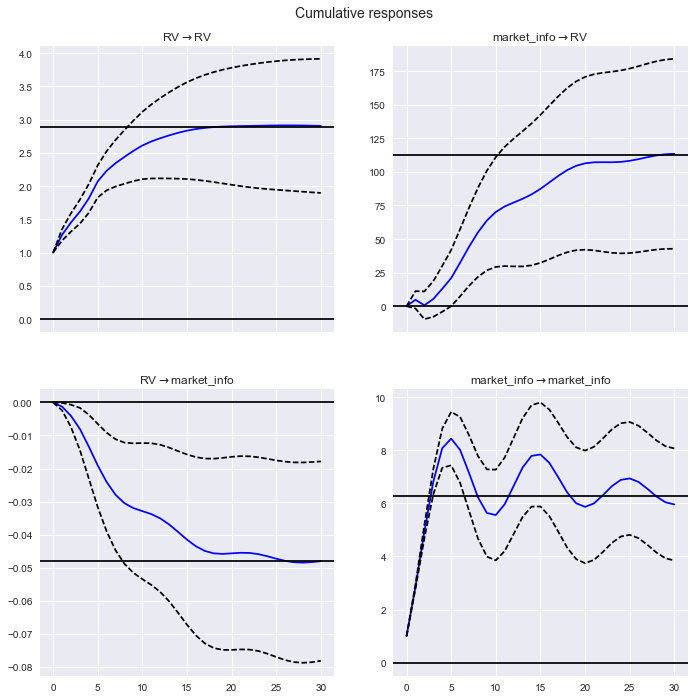

KO 



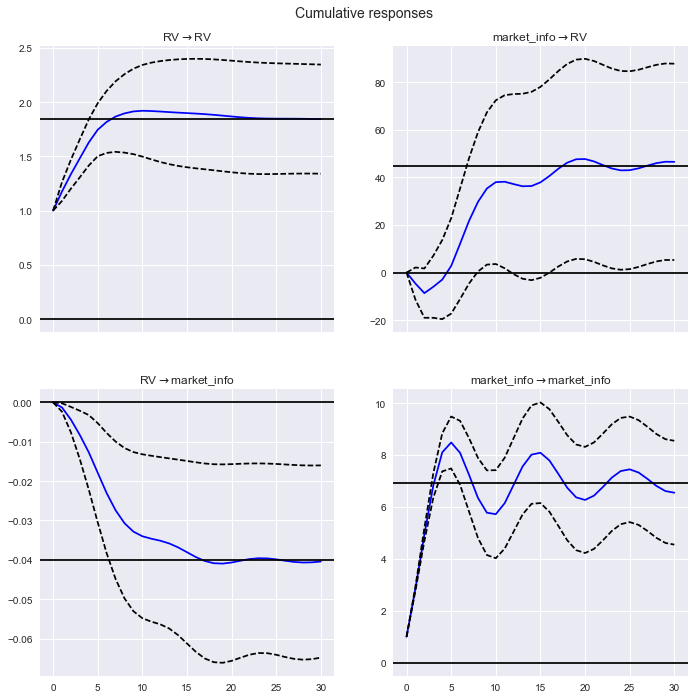

INTC 



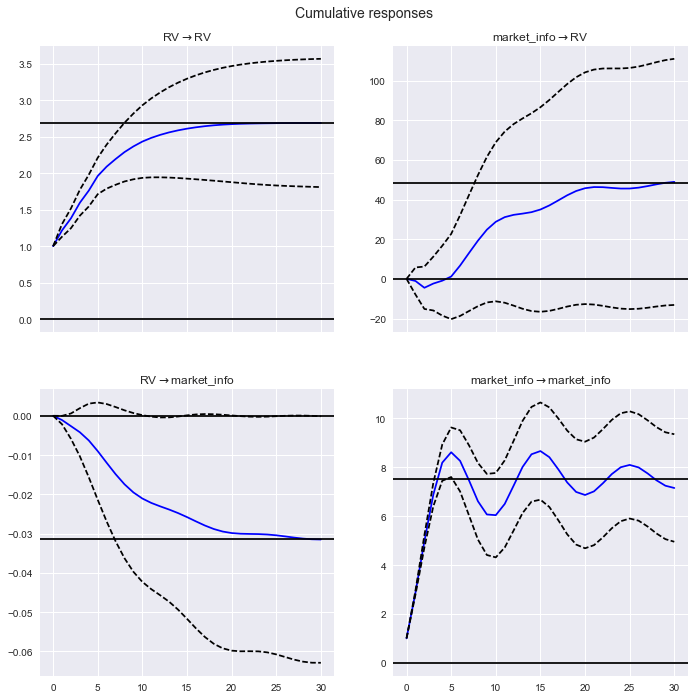

PFE 



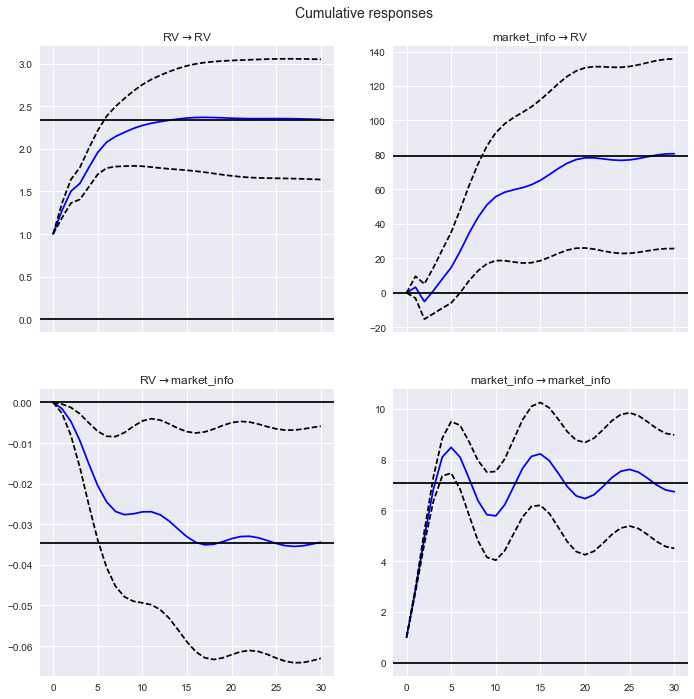

TRV 



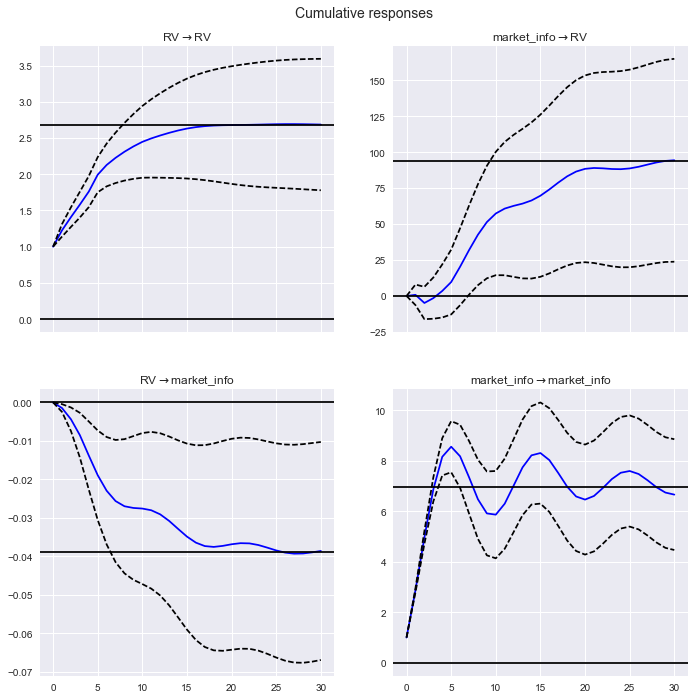

CSCO 



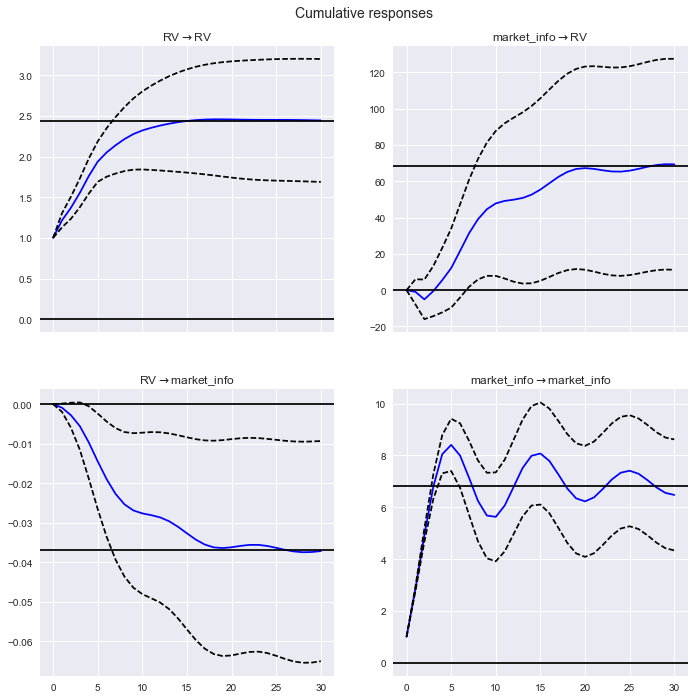

UNH 



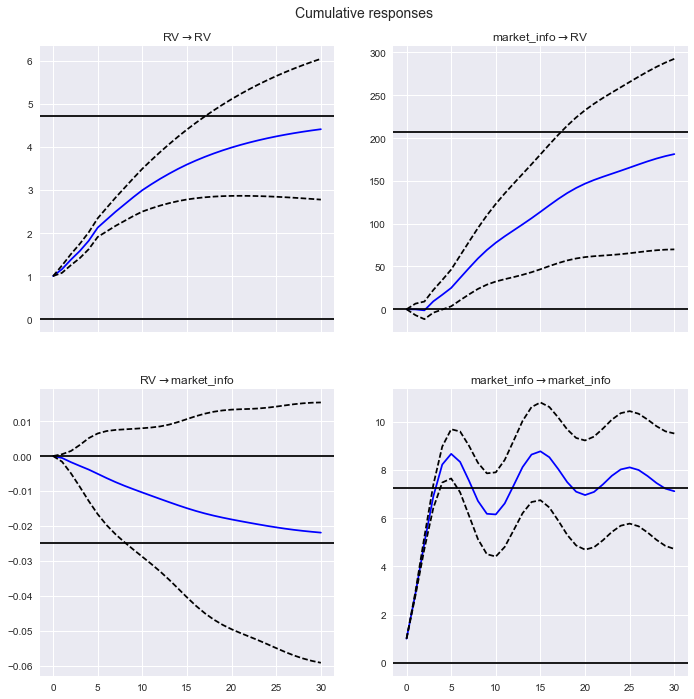

PG 



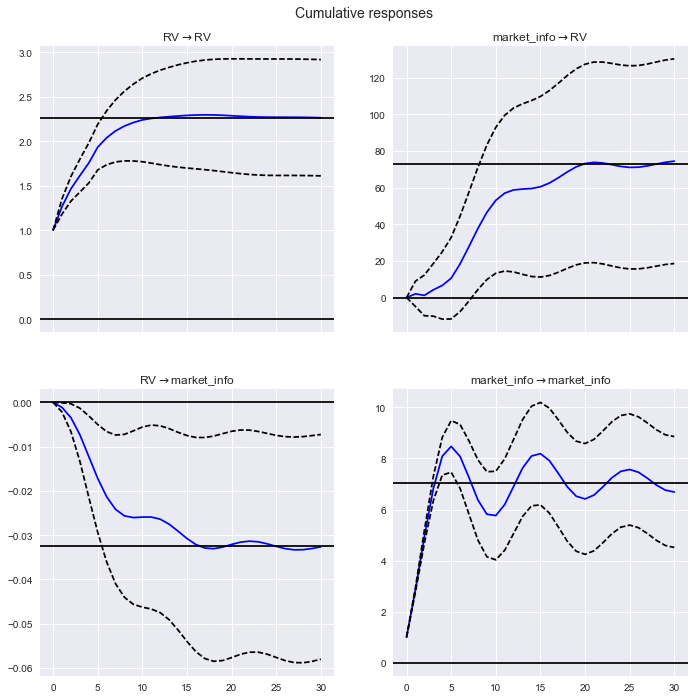

MMM 



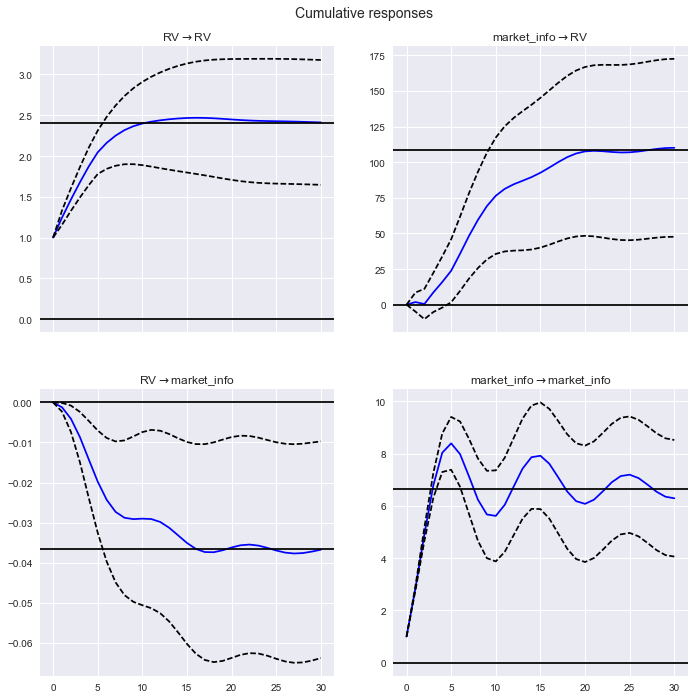

AAPL 



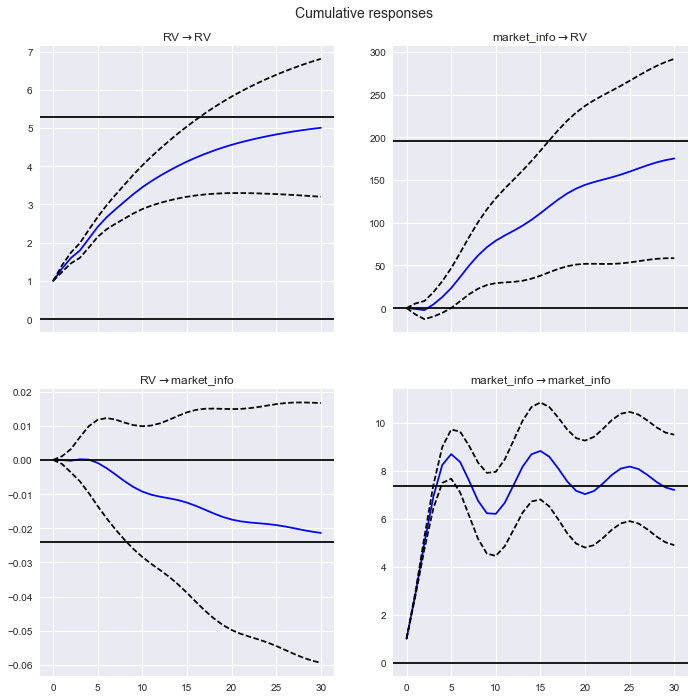

MRK 



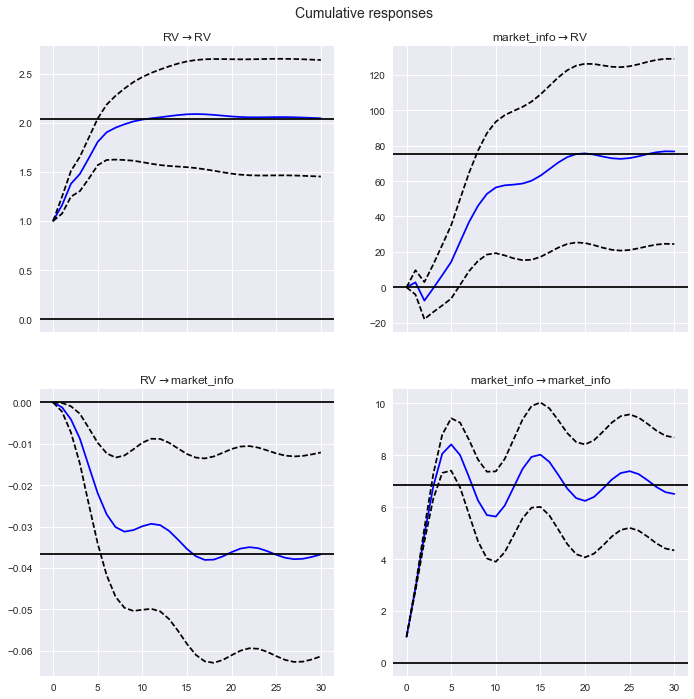

WMT 



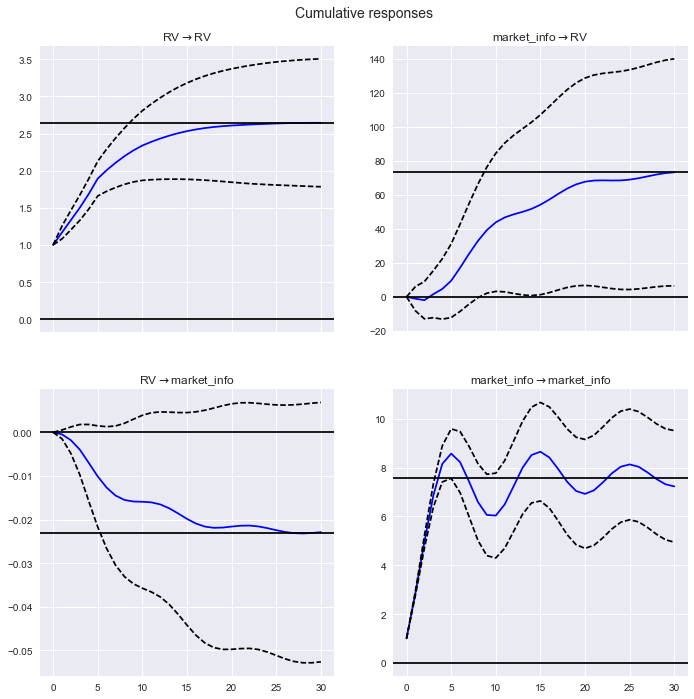

NKE 



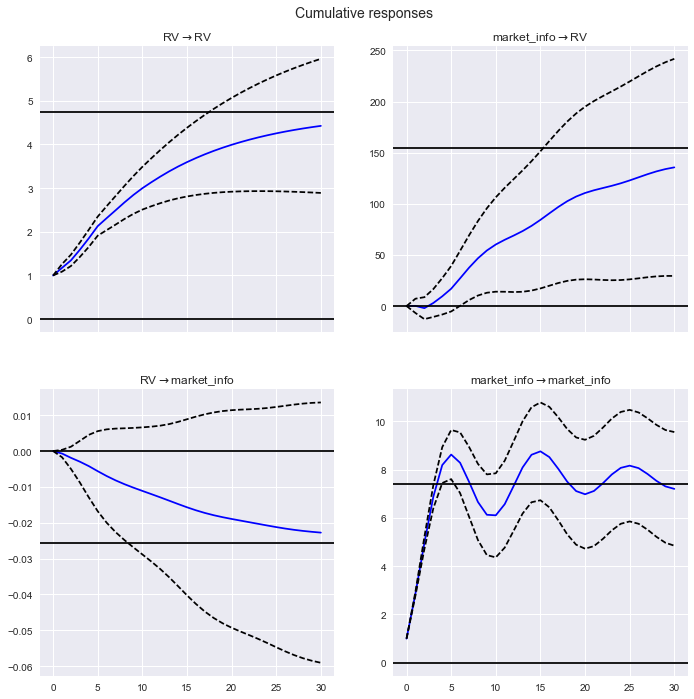

In [32]:
for k in results_dict.keys():
    # Calculate impulse response analysis
    print(k,'\n')
    irf = results_dict[k].irf(30)
    irf.plot_cum_effects(orth=False)
    plt.show()

## EXOG-VAR in difference model

In [115]:
df = pd.read_csv(path + 'regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df = df[(df.Date.dt.year > 2010) & (df.Date.dt.year < 2018)]
# Select variables for the VAR
var_data = df[['Date','Ticker','RV','SVI','ret','SPY','market_info']]
var_data = var_data.set_index('Date')

class mi_varmax_model:
    
    def __init__(self,data):
        self.data = data
        
    def train_model(self, trend='c', error_cov_type='diagonal', enforce_invertibility=True, maxlags = 5, ic='bic', cov_type='robust'):
        
        ''' Train model '''
        
        from statsmodels.tsa.api import VARMAX 
        
        self.pvalues = pd.DataFrame()
        self.parameters = pd.DataFrame()
        self.results_dict = dict()

        print('Training...')
            
        for t, data in self.data.groupby('Ticker'):
            
            endog = ['RV','SVI']
            endog = data[endog].dropna()
            exog = ['SPY','market_info']
            exog = data[exog].dropna()
            # Especify model
            self.model = VARMAX(endog.values, 
                           trend=trend, 
                           exog=exog.values, 
                           error_cov_type=error_cov_type,
                           enforce_invertibility=enforce_invertibility)
            # Fit model
            results = self.model.fit(maxiter=3000, maxlags = 5, ic='bic', cov_type='robust')
            self.results_dict[t] = results
            # Get model coeficients
            df_coef = pd.DataFrame(results.params).T
            df_coef['Ticker'] = t
            self.parameters = pd.concat([self.parameters, df_coef])

            # Get model pvalues
            df_pvals = pd.DataFrame(results.pvalues).T
            df_pvals['Ticker'] = t
            self.pvalues = pd.concat([self.pvalues, df_pvals])   
            
    def mean_cumulative_response(self):
        
        cum_res = 0
        for k in results_dict.keys():
            cum_res += self.results_dict[k].impulse_responses(30, cumulative=True)[-1:,1]

        return(cum_res/len(results_dict))
    
    def mean_heteroskedasticity_test(self):
        
        ''' Mean future cumulative response:
            The null hypothesis is of no heteroskedasticity in the residuals. '''
        
        mean_p = 0
        for k in results_dict.keys():
            mean_p += self.results_dict[k].test_heteroskedasticity(method=None)[:,1].mean()

        return(mean_p/len(self.results_dict))
    
    def mean_normality_test(self):
        
        ''' Test for normality in the residuals 
            Null hypothesis is normality of the residuals. '''
        mean_p = 0
        for k in results_dict.keys():
            mean_p += self.results_dict[k].test_normality(method = 'jarquebera')[:,1].mean()

        return(mean_p/len(self.results_dict))
        


In [119]:
search_grid = {'error_cov_type':['diagonal'],
               'enforce_invertibility':[True],
               'ic':['bic'],
               'cov_type':['robust','opg','approx',None]}
var_results = pd.DataFrame()

instance = mi_varmax_model(data = var_data)

for ct in search_grid['cov_type']:
    for ei in search_grid['enforce_invertibility']:
        for ic in search_grid['ic']:
            instance.train_model(cov_type = ect,enforce_invertibility=ei,ic = ic )
            cr = instance.mean_cumulative_response()
            ht = instance.mean_heteroskedasticity_test()
            nt = instance.mean_normality_test()
            
            aux = pd.DataFrame({'ct':ect,
                                'ei':ei,
                                'ic':ic,
                                'cr':cr,
                                'ht':ht,
                                'nt':nt})
            
            var_results = pd.concat([var_results, aux])
            
var_results       

Training...


C:\Users\jaime.oliver\AppData\Local\Continuum\Anaconda3\lib\site-packages\statsmodels\tsa\vector_ar\var_model.py:461: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  params = np.linalg.lstsq(z, y_sample)[0]


Training...
Training...
Training...


,cr,ct,ei,ht,ic,nt
0,-0.168208,diagonal,True,0.427244,bic,0.308379
0,-0.168208,diagonal,True,0.427244,bic,0.308379
0,-0.168208,diagonal,True,0.427244,bic,0.308379
0,-0.168208,diagonal,True,0.427244,bic,0.308379
